In [1]:
# If you forked the repository, you can replace the link.
repo_url = 'https://github.com/dctian/DeepPiCar'

# Number of training steps.
num_steps = 200000

# Number of evaluation steps.
num_eval_steps = 50

# model configs are from Model Zoo github: 
MODELS_CONFIG = {
    #http://download.tensorflow.org/models/object_detection/ssd_mobilenet_v1_quantized_300x300_coco14_sync_2018_07_18.tar.gz
    'ssd_mobilenet_v1_quantized': {
        'model_name': 'ssd_mobilenet_v1_quantized_300x300_coco14_sync_2018_07_18',
        'pipeline_file': 'ssd_mobilenet_v1_quantized_300x300_coco14_sync.config',
        'batch_size': 12
    },    
    #http://download.tensorflow.org/models/object_detection/ssd_mobilenet_v2_quantized_300x300_coco_2019_01_03.tar.gz
    'ssd_mobilenet_v2_quantized': {
        'model_name': 'ssd_mobilenet_v2_quantized_300x300_coco_2019_01_03',
        'pipeline_file': 'ssd_mobilenet_v2_quantized_300x300_coco.config',
        'batch_size': 4
    },
}

# Pick the model you want to use
selected_model = 'ssd_mobilenet_v2_quantized'

# Name of the object detection model to use.
MODEL = MODELS_CONFIG[selected_model]['model_name']

# Name of the pipline file in tensorflow object detection API.
pipeline_file = MODELS_CONFIG[selected_model]['pipeline_file']

# Training batch size fits in Colabe's Tesla K80 GPU memory for selected model.
batch_size = MODELS_CONFIG[selected_model]['batch_size']

!git clone https://github.com/dctian/DeepPiCar
  

!git clone https://github.com/tensorflow/models.git

#!apt-get install -qq protobuf-compiler python-pil python-lxml python-tk
#!pip install -q Cython contextlib2 pillow lxml matplotlib
#!pip install -q pycocotools
%cd models/research
!protoc object_detection/protos/*.proto --python_out=.


fatal: destination path 'DeepPiCar' already exists and is not an empty directory.
fatal: destination path 'models' already exists and is not an empty directory.
/home/jakubtomaszewski/Dokumenty/RobotyMobilne/ObjectDetection/models/research
object_detection/protos/input_reader.proto:5:1: warning: Import object_detection/protos/image_resizer.proto is unused.


In [2]:

import os
#os.environ['PYTHONPATH'] = '/opt/ros/melodic/lib/python2.7/dist-packages:~/Dokumenty/RobotyMobilne/ObjectDetection/models/research/:~/Dokumenty/RobotyMobilne/ObjectDetection/models/research/slim/'
#os.environ['PYTHONPATH'] = '/home/jakubtomaszewski/Dokumenty/RobotyMobilne/ObjectDetection/models/research/:/home/jakubtomaszewski/Dokumenty/RobotyMobilne/ObjectDetection/models/research/slim/'
import sys
sys.path


['/home/jakubtomaszewski/Dokumenty/RobotyMobilne/ObjectDetection',
 '/home/jakubtomaszewski/Dokumenty/RobotyMobilne/ObjectDetection',
 '/home/jakubtomaszewski/Dokumenty/RobotyMobilne/ObjectDetection/models/research',
 '/home/jakubtomaszewski/Dokumenty/RobotyMobilne/ObjectDetection/models/research/slim',
 '/home/jakubtomaszewski/anaconda3/lib/python37.zip',
 '/home/jakubtomaszewski/anaconda3/lib/python3.7',
 '/home/jakubtomaszewski/anaconda3/lib/python3.7/lib-dynload',
 '',
 '/home/jakubtomaszewski/anaconda3/lib/python3.7/site-packages',
 '/home/jakubtomaszewski/anaconda3/lib/python3.7/site-packages/IPython/extensions',
 '/home/jakubtomaszewski/.ipython']

In [3]:
repo_dir_path = '/home/jakubtomaszewski/Dokumenty/RobotyMobilne/ObjectDetection/DeepPiCar'
%cd {repo_dir_path}/models/object_detection
!pwd
# Convert train folder annotation xml files to a single csv file,
# generate the `label_map.pbtxt` file to `data/` directory as well.
!python code/xml_to_csv.py -i data/images/train -o data/annotations/train_labels.csv -l data/annotations

# Convert test folder annotation xml files to a single csv.
!python code/xml_to_csv.py -i data/images/test -o data/annotations/test_labels.csv

# Generate `train.record`
!python code/generate_tfrecord.py --csv_input=data/annotations/train_labels.csv --output_path=data/annotations/train.record --img_path=data/images/train --label_map data/annotations/label_map.pbtxt

# Generate `test.record`
!python code/generate_tfrecord.py --csv_input=data/annotations/test_labels.csv --output_path=data/annotations/test.record --img_path=data/images/test --label_map data/annotations/label_map.pbtxt

/home/jakubtomaszewski/Dokumenty/RobotyMobilne/ObjectDetection/DeepPiCar/models/object_detection
/home/jakubtomaszewski/Dokumenty/RobotyMobilne/ObjectDetection/DeepPiCar/models/object_detection
Successfully converted xml to csv.
Generate `data/annotations/label_map.pbtxt`
Successfully converted xml to csv.


W0523 17:09:05.675893 140674478909248 deprecation_wrapper.py:119] From code/generate_tfrecord.py:107: The name tf.python_io.TFRecordWriter is deprecated. Please use tf.io.TFRecordWriter instead.


W0523 17:09:05.748728 140674478909248 deprecation_wrapper.py:119] From code/generate_tfrecord.py:53: The name tf.gfile.GFile is deprecated. Please use tf.io.gfile.GFile instead.

Successfully created the TFRecords: /home/jakubtomaszewski/Dokumenty/RobotyMobilne/ObjectDetection/DeepPiCar/models/object_detection/data/annotations/train.record


W0523 17:09:07.072082 140142481700672 deprecation_wrapper.py:119] From code/generate_tfrecord.py:107: The name tf.python_io.TFRecordWriter is depreca

In [4]:
test_record_fname = repo_dir_path + '/models/object_detection/data/annotations/test.record'
train_record_fname = repo_dir_path + '/models/object_detection/data/annotations/train.record'
label_map_pbtxt_fname = repo_dir_path + '/models/object_detection/data/annotations/label_map.pbtxt'

In [5]:
!cat data/annotations/test_labels.csv

filename,width,height,class,xmin,ymin,xmax,ymax
stop_061.png,640,480,stop,56,114,159,200
stop_091.png,640,480,stop,32,80,105,153
stop_091.png,640,480,stop,483,87,546,155
green_light_034.png,640,480,green_sign,319,8,397,144
red_light_012.png,640,480,red_light,177,35,249,151
stop_007.png,640,480,stop,97,83,194,186
stop_007.png,640,480,stop,269,93,339,171
green_light_022.png,640,480,green_sign,306,116,328,166
green_light_028.png,640,480,green_sign,155,30,221,150
red_light_038.png,640,480,red_light,333,66,382,155
red_light_004.png,640,480,red_light,297,115,331,170
red_light_016.png,640,480,red_light,159,100,203,168
red_light_087.png,640,480,red_light,236,127,270,180
stop_029.png,640,480,stop,176,157,340,317
red_light_122.png,640,480,red_light,223,121,263,179
stop_032.png,640,480,stop,293,215,367,271
red_light_049.png,640,480,red_light,338,322,397,400
green_light_043.png,640,480,green_sign,324,96,361,163
green_light_011.png,640,480,green_sign,274,123,419,287
red_light_052.png,640,480,red_li

In [6]:
import os
import shutil
import glob
import urllib.request
import tarfile
MODEL_FILE = MODEL + '.tar.gz'
DOWNLOAD_BASE = 'http://download.tensorflow.org/models/object_detection/'
DEST_DIR = '/home/jakubtomaszewski/Dokumenty/RobotyMobilne/ObjectDetection/DeepPiCar/models/object_detection/pretrained_model'
DEST_NAME = 'pretrained_model'
if not (os.path.exists(MODEL_FILE)):
    urllib.request.urlretrieve(DOWNLOAD_BASE + MODEL_FILE, MODEL_FILE)

tar = tarfile.open(MODEL_FILE)
tar.extractall()
tar.close()

import shutil
os.remove(MODEL_FILE)
if (os.path.exists(DEST_DIR)):
    shutil.rmtree(DEST_DIR)
try:
    os.rename(MODEL, DEST_NAME)
finally:
    print("error")

error


In [7]:
!echo {DEST_DIR}
!ls -alh {DEST_DIR}

/home/jakubtomaszewski/Dokumenty/RobotyMobilne/ObjectDetection/DeepPiCar/models/object_detection/pretrained_model
razem 204M
drwx------ 2 jakubtomaszewski jakubtomaszewski 4,0K sty  4  2019 .
drwxr-xr-x 6 jakubtomaszewski jakubtomaszewski 4,0K maj 23 17:10 ..
-rw------- 1 jakubtomaszewski jakubtomaszewski  93M sty  4  2019 model.ckpt.data-00000-of-00001
-rw------- 1 jakubtomaszewski jakubtomaszewski  68K sty  4  2019 model.ckpt.index
-rw------- 1 jakubtomaszewski jakubtomaszewski  20M sty  4  2019 model.ckpt.meta
-rw------- 1 jakubtomaszewski jakubtomaszewski 4,3K sty  4  2019 pipeline.config
-rw------- 1 jakubtomaszewski jakubtomaszewski  24M sty  4  2019 tflite_graph.pb
-rw------- 1 jakubtomaszewski jakubtomaszewski  68M sty  4  2019 tflite_graph.pbtxt


In [8]:
fine_tune_checkpoint = os.path.join(DEST_DIR, "model.ckpt")
print(fine_tune_checkpoint)

/home/jakubtomaszewski/Dokumenty/RobotyMobilne/ObjectDetection/DeepPiCar/models/object_detection/pretrained_model/model.ckpt


In [9]:
import os
pipeline_fname = os.path.join('/home/jakubtomaszewski/Dokumenty/RobotyMobilne/ObjectDetection/models/research/object_detection/samples/configs/', pipeline_file)

assert os.path.isfile(pipeline_fname), '`{}` not exist'.format(pipeline_fname)

In [10]:
def get_num_classes(pbtxt_fname):
    from object_detection.utils import label_map_util
    label_map = label_map_util.load_labelmap(pbtxt_fname)
    categories = label_map_util.convert_label_map_to_categories(
        label_map, max_num_classes=90, use_display_name=True)
    category_index = label_map_util.create_category_index(categories)
    return len(category_index.keys())

In [11]:
import re

# training pipeline file defines:
# - pretrain model path
# - the train/test sets
# - ID to Label mapping and number of classes
# - training batch size
# - epochs to trains
# - learning rate
# - etc

# note we just need to use a sample one, and make edits to it.

num_classes = get_num_classes(label_map_pbtxt_fname)
with open(pipeline_fname) as f:
    s = f.read()
with open(pipeline_fname, 'w') as f:
    
    # fine_tune_checkpoint: downloaded pre-trained model checkpoint path
    s = re.sub('fine_tune_checkpoint: ".*?"',
               'fine_tune_checkpoint: "{}"'.format(fine_tune_checkpoint), s)
    
    # tfrecord files train and test, we created earlier with our training/test sets
    s = re.sub(
        '(input_path: ".*?)(train.record)(.*?")', 'input_path: "{}"'.format(train_record_fname), s)
    s = re.sub(
        '(input_path: ".*?)(val.record)(.*?")', 'input_path: "{}"'.format(test_record_fname), s)

    # label_map_path: ID to label file
    s = re.sub(
        'label_map_path: ".*?"', 'label_map_path: "{}"'.format(label_map_pbtxt_fname), s)

    # Set training batch_size.
    s = re.sub('batch_size: [0-9]+',
               'batch_size: {}'.format(batch_size), s)

    # Set training steps, num_steps (Number of epochs to train)
    s = re.sub('num_steps: [0-9]+',
               'num_steps: {}'.format(num_steps), s)
    
    # Set number of classes num_classes.
    s = re.sub('num_classes: [0-9]+',
               'num_classes: {}'.format(num_classes), s)
    f.write(s)

In [12]:
!cat {label_map_pbtxt_fname}

item {
    id: 1
    name: 'green_sign'
}

item {
    id: 2
    name: 'red_light'
}

item {
    id: 3
    name: 'stop'
}

In [13]:
!cat {pipeline_fname}

# Quantized trained SSD with Mobilenet v2 on MSCOCO Dataset.
# Users should configure the fine_tune_checkpoint field in the train config as
# well as the label_map_path and input_path fields in the train_input_reader and
# eval_input_reader. Search for "PATH_TO_BE_CONFIGURED" to find the fields that
# should be configured.

model {
  ssd {
    num_classes: 3
    box_coder {
      faster_rcnn_box_coder {
        y_scale: 10.0
        x_scale: 10.0
        height_scale: 5.0
        width_scale: 5.0
      }
    }
    matcher {
      argmax_matcher {
        matched_threshold: 0.5
        unmatched_threshold: 0.5
        ignore_thresholds: false
        negatives_lower_than_unmatched: true
        force_match_for_each_row: true
      }
    }
    similarity_calculator {
      iou_similarity {
      }
    }
    anchor_generator {
      ssd_anchor_generator {
        num_layers: 6
        min_scale: 0.2
        max_scale: 0.95
        aspect_ratios: 1.0
        aspect_ratios: 2.0
        aspe

In [14]:
!wget https://bin.equinox.io/c/4VmDzA7iaHb/ngrok-stable-linux-amd64.zip
!unzip -o ngrok-stable-linux-amd64.zip

--2020-05-23 17:10:10--  https://bin.equinox.io/c/4VmDzA7iaHb/ngrok-stable-linux-amd64.zip
Translacja bin.equinox.io (bin.equinox.io)... 54.164.74.108, 3.95.144.123, 54.209.102.93, ...
Łączenie się z bin.equinox.io (bin.equinox.io)|54.164.74.108|:443... połączono.
Żądanie HTTP wysłano, oczekiwanie na odpowiedź... 200 OK
Długość: 13773305 (13M) [application/octet-stream]
Zapis do: `ngrok-stable-linux-amd64.zip.1'

ngrok-stable-linux- 100%[===================>]  13,13M  2,62MB/s    w 5,6s     

2020-05-23 17:10:16 (2,35 MB/s) - zapisano `ngrok-stable-linux-amd64.zip.1' [13773305/13773305]

Archive:  ngrok-stable-linux-amd64.zip
  inflating: ngrok                   


In [15]:
model_dir = '/home/jakubtomaszewski/Dokumenty/RobotyMobilne/ObjectDetection/DeepPiCar/models/object_detection/Training'

LOG_DIR = model_dir
get_ipython().system_raw(
    'tensorboard --logdir "{}" --host 0.0.0.0 --port 6006 &'
    .format(LOG_DIR)
)

In [16]:
get_ipython().system_raw('./ngrok http 6006 &')

In [17]:
! curl -s http://localhost:4040/api/tunnels | python3 -c \
    "import sys, json; print(json.load(sys.stdin)['tunnels'][0]['public_url'])"

Traceback (most recent call last):
  File "<string>", line 1, in <module>
IndexError: list index out of range


In [18]:


#model_dir = '/content/gdrive/My Drive/Colab Notebooks/TransferLearning/Training'
model_dir = '/home/jakubtomaszewski/Dokumenty/RobotyMobilne/ObjectDetection/DeepPiCar/models/object_detection/Training'
pipeline_file = 'ssd_mobilenet_v2_quantized_300x300_coco.config'

!python ~/Dokumenty/RobotyMobilne/ObjectDetection/models/research/object_detection/model_main.py \
    --pipeline_config_path={pipeline_fname} \
    --model_dir='{model_dir}' \
    --alsologtostderr \
    --num_train_steps={num_steps} \
    --num_eval_steps={num_eval_steps}



2020-05-23 17:10:18.187424: I tensorflow/core/platform/cpu_feature_guard.cc:142] Your CPU supports instructions that this TensorFlow binary was not compiled to use: SSE4.1 SSE4.2 AVX AVX2 FMA
2020-05-23 17:10:18.211121: I tensorflow/core/platform/profile_utils/cpu_utils.cc:94] CPU Frequency: 3892630000 Hz
2020-05-23 17:10:18.211693: I tensorflow/compiler/xla/service/service.cc:168] XLA service 0x5616f2981650 executing computations on platform Host. Devices:
2020-05-23 17:10:18.211722: I tensorflow/compiler/xla/service/service.cc:175]   StreamExecutor device (0): <undefined>, <undefined>
2020-05-23 17:10:18.212507: I tensorflow/stream_executor/platform/default/dso_loader.cc:42] Successfully opened dynamic library libcuda.so.1
2020-05-23 17:10:18.249365: I tensorflow/stream_executor/cuda/cuda_gpu_executor.cc:1005] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero
2020-05-23 17:10:18.249692: I tensorflow/c

Instructions for updating:
Use `tf.data.Dataset.map()
W0523 17:10:18.875241 139887936673600 deprecation.py:323] From /home/jakubtomaszewski/Dokumenty/RobotyMobilne/ObjectDetection/models/research/object_detection/builders/dataset_builder.py:182: DatasetV1.map_with_legacy_function (from tensorflow.python.data.ops.dataset_ops) is deprecated and will be removed in a future version.
Instructions for updating:
Use `tf.data.Dataset.map()

W0523 17:10:18.955708 139887936673600 deprecation_wrapper.py:119] From /home/jakubtomaszewski/Dokumenty/RobotyMobilne/ObjectDetection/models/research/object_detection/utils/ops.py:498: The name tf.is_nan is deprecated. Please use tf.math.is_nan instead.

Instructions for updating:
Use tf.where in 2.0, which has the same broadcast rule as np.where
W0523 17:10:18.957614 139887936673600 deprecation.py:323] From /home/jakubtomaszewski/Dokumenty/RobotyMobilne/ObjectDetection/models/research/object_detection/utils/ops.py:500: add_dispatch_support.<locals>.wrapper

W0523 17:10:19.983416 139887936673600 ag_logging.py:145] Entity <bound method BatchNormalization.call of <tensorflow.python.layers.normalization.BatchNormalization object at 0x7f3858586a90>> could not be transformed and will be executed as-is. Please report this to the AutgoGraph team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output. Cause: converting <bound method BatchNormalization.call of <tensorflow.python.layers.normalization.BatchNormalization object at 0x7f3858586a90>>: AssertionError: Bad argument number for Name: 3, expecting 4
W0523 17:10:20.031244 139887936673600 ag_logging.py:145] Entity <bound method Conv.call of <tensorflow.python.layers.convolutional.Conv2D object at 0x7f38585869d0>> could not be transformed and will be executed as-is. Please report this to the AutgoGraph team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output. Cause: conv

W0523 17:10:20.282767 139887936673600 ag_logging.py:145] Entity <bound method Conv.call of <tensorflow.python.layers.convolutional.Conv2D object at 0x7f38585b2fd0>> could not be transformed and will be executed as-is. Please report this to the AutgoGraph team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output. Cause: converting <bound method Conv.call of <tensorflow.python.layers.convolutional.Conv2D object at 0x7f38585b2fd0>>: AssertionError: Bad argument number for Name: 3, expecting 4
W0523 17:10:20.300721 139887936673600 ag_logging.py:145] Entity <bound method BatchNormalization.call of <tensorflow.python.layers.normalization.BatchNormalization object at 0x7f3858294590>> could not be transformed and will be executed as-is. Please report this to the AutgoGraph team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output. Cause: converting <bound method Batch

W0523 17:10:20.549504 139887936673600 ag_logging.py:145] Entity <bound method BatchNormalization.call of <tensorflow.python.layers.normalization.BatchNormalization object at 0x7f385803f290>> could not be transformed and will be executed as-is. Please report this to the AutgoGraph team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output. Cause: converting <bound method BatchNormalization.call of <tensorflow.python.layers.normalization.BatchNormalization object at 0x7f385803f290>>: AssertionError: Bad argument number for Name: 3, expecting 4
W0523 17:10:20.596665 139887936673600 ag_logging.py:145] Entity <bound method Conv.call of <tensorflow.python.layers.convolutional.Conv2D object at 0x7f385823e690>> could not be transformed and will be executed as-is. Please report this to the AutgoGraph team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output. Cause: conv

W0523 17:10:20.816416 139887936673600 ag_logging.py:145] Entity <bound method Conv.call of <tensorflow.python.layers.convolutional.Conv2D object at 0x7f3853f1b450>> could not be transformed and will be executed as-is. Please report this to the AutgoGraph team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output. Cause: converting <bound method Conv.call of <tensorflow.python.layers.convolutional.Conv2D object at 0x7f3853f1b450>>: AssertionError: Bad argument number for Name: 3, expecting 4
W0523 17:10:20.833759 139887936673600 ag_logging.py:145] Entity <bound method BatchNormalization.call of <tensorflow.python.layers.normalization.BatchNormalization object at 0x7f3853df2590>> could not be transformed and will be executed as-is. Please report this to the AutgoGraph team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output. Cause: converting <bound method Batch

W0523 17:10:21.173839 139887936673600 ag_logging.py:145] Entity <bound method Conv.call of <tensorflow.python.layers.convolutional.Conv2D object at 0x7f3871f10c10>> could not be transformed and will be executed as-is. Please report this to the AutgoGraph team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output. Cause: converting <bound method Conv.call of <tensorflow.python.layers.convolutional.Conv2D object at 0x7f3871f10c10>>: AssertionError: Bad argument number for Name: 3, expecting 4
W0523 17:10:21.191376 139887936673600 ag_logging.py:145] Entity <bound method BatchNormalization.call of <tensorflow.python.layers.normalization.BatchNormalization object at 0x7f3853f6b250>> could not be transformed and will be executed as-is. Please report this to the AutgoGraph team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output. Cause: converting <bound method Batch

W0523 17:10:21.411915 139887936673600 ag_logging.py:145] Entity <bound method BatchNormalization.call of <tensorflow.python.layers.normalization.BatchNormalization object at 0x7f385bf0bd50>> could not be transformed and will be executed as-is. Please report this to the AutgoGraph team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output. Cause: converting <bound method BatchNormalization.call of <tensorflow.python.layers.normalization.BatchNormalization object at 0x7f385bf0bd50>>: AssertionError: Bad argument number for Name: 3, expecting 4
W0523 17:10:21.438698 139887936673600 ag_logging.py:145] Entity <bound method BatchNormalization.call of <tensorflow.python.layers.normalization.BatchNormalization object at 0x7f385bf050d0>> could not be transformed and will be executed as-is. Please report this to the AutgoGraph team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach th

W0523 17:10:21.705687 139887936673600 ag_logging.py:145] Entity <bound method Conv.call of <tensorflow.python.layers.convolutional.Conv2D object at 0x7f3858cd2490>> could not be transformed and will be executed as-is. Please report this to the AutgoGraph team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output. Cause: converting <bound method Conv.call of <tensorflow.python.layers.convolutional.Conv2D object at 0x7f3858cd2490>>: AssertionError: Bad argument number for Name: 3, expecting 4
W0523 17:10:21.723561 139887936673600 ag_logging.py:145] Entity <bound method BatchNormalization.call of <tensorflow.python.layers.normalization.BatchNormalization object at 0x7f385b6de990>> could not be transformed and will be executed as-is. Please report this to the AutgoGraph team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output. Cause: converting <bound method Batch

W0523 17:10:21.955551 139887936673600 ag_logging.py:145] Entity <bound method Conv.call of <tensorflow.python.layers.convolutional.Conv2D object at 0x7f38585c3950>> could not be transformed and will be executed as-is. Please report this to the AutgoGraph team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output. Cause: converting <bound method Conv.call of <tensorflow.python.layers.convolutional.Conv2D object at 0x7f38585c3950>>: AssertionError: Bad argument number for Name: 3, expecting 4
W0523 17:10:21.973731 139887936673600 ag_logging.py:145] Entity <bound method BatchNormalization.call of <tensorflow.python.layers.normalization.BatchNormalization object at 0x7f3858eac2d0>> could not be transformed and will be executed as-is. Please report this to the AutgoGraph team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output. Cause: converting <bound method Batch

W0523 17:10:22.318895 139887936673600 ag_logging.py:145] Entity <bound method BatchNormalization.call of <tensorflow.python.layers.normalization.BatchNormalization object at 0x7f385bb84bd0>> could not be transformed and will be executed as-is. Please report this to the AutgoGraph team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output. Cause: converting <bound method BatchNormalization.call of <tensorflow.python.layers.normalization.BatchNormalization object at 0x7f385bb84bd0>>: AssertionError: Bad argument number for Name: 3, expecting 4
W0523 17:10:22.367427 139887936673600 ag_logging.py:145] Entity <bound method Conv.call of <tensorflow.python.layers.convolutional.Conv2D object at 0x7f385b7b53d0>> could not be transformed and will be executed as-is. Please report this to the AutgoGraph team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output. Cause: conv

W0523 17:10:22.596377 139887936673600 ag_logging.py:145] Entity <bound method Conv.call of <tensorflow.python.layers.convolutional.Conv2D object at 0x7f385b91a0d0>> could not be transformed and will be executed as-is. Please report this to the AutgoGraph team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output. Cause: converting <bound method Conv.call of <tensorflow.python.layers.convolutional.Conv2D object at 0x7f385b91a0d0>>: AssertionError: Bad argument number for Name: 3, expecting 4
W0523 17:10:22.614271 139887936673600 ag_logging.py:145] Entity <bound method BatchNormalization.call of <tensorflow.python.layers.normalization.BatchNormalization object at 0x7f385b65dd90>> could not be transformed and will be executed as-is. Please report this to the AutgoGraph team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output. Cause: converting <bound method Batch

W0523 17:10:22.848827 139887936673600 ag_logging.py:145] Entity <bound method BatchNormalization.call of <tensorflow.python.layers.normalization.BatchNormalization object at 0x7f385b3c4d90>> could not be transformed and will be executed as-is. Please report this to the AutgoGraph team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output. Cause: converting <bound method BatchNormalization.call of <tensorflow.python.layers.normalization.BatchNormalization object at 0x7f385b3c4d90>>: AssertionError: Bad argument number for Name: 3, expecting 4
W0523 17:10:22.896713 139887936673600 ag_logging.py:145] Entity <bound method Conv.call of <tensorflow.python.layers.convolutional.Conv2D object at 0x7f3858745990>> could not be transformed and will be executed as-is. Please report this to the AutgoGraph team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output. Cause: conv

W0523 17:10:23.159296 139887936673600 ag_logging.py:145] Entity <bound method Conv.call of <tensorflow.python.layers.convolutional.Conv2D object at 0x7f385b5cbf10>> could not be transformed and will be executed as-is. Please report this to the AutgoGraph team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output. Cause: converting <bound method Conv.call of <tensorflow.python.layers.convolutional.Conv2D object at 0x7f385b5cbf10>>: AssertionError: Bad argument number for Name: 3, expecting 4
W0523 17:10:23.177635 139887936673600 ag_logging.py:145] Entity <bound method BatchNormalization.call of <tensorflow.python.layers.normalization.BatchNormalization object at 0x7f38591cd510>> could not be transformed and will be executed as-is. Please report this to the AutgoGraph team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output. Cause: converting <bound method Batch

W0523 17:10:23.831335 139887936673600 ag_logging.py:145] Entity <bound method Conv.call of <tensorflow.python.layers.convolutional.Conv2D object at 0x7f38539fde50>> could not be transformed and will be executed as-is. Please report this to the AutgoGraph team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output. Cause: converting <bound method Conv.call of <tensorflow.python.layers.convolutional.Conv2D object at 0x7f38539fde50>>: AssertionError: Bad argument number for Name: 3, expecting 4
W0523 17:10:23.876982 139887936673600 ag_logging.py:145] Entity <bound method Conv.call of <tensorflow.python.layers.convolutional.Conv2D object at 0x7f38539fd910>> could not be transformed and will be executed as-is. Please report this to the AutgoGraph team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output. Cause: converting <bound method Conv.call of <tensorflow.python

W0523 17:10:24.198586 139887936673600 ag_logging.py:145] Entity <bound method Conv.call of <tensorflow.python.layers.convolutional.Conv2D object at 0x7f38539fde50>> could not be transformed and will be executed as-is. Please report this to the AutgoGraph team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output. Cause: converting <bound method Conv.call of <tensorflow.python.layers.convolutional.Conv2D object at 0x7f38539fde50>>: AssertionError: Bad argument number for Name: 3, expecting 4
W0523 17:10:24.244522 139887936673600 ag_logging.py:145] Entity <bound method Conv.call of <tensorflow.python.layers.convolutional.Conv2D object at 0x7f38539fda10>> could not be transformed and will be executed as-is. Please report this to the AutgoGraph team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output. Cause: converting <bound method Conv.call of <tensorflow.python

Instructions for updating:
Call initializer instance with the dtype argument instead of passing it to the constructor
W0523 17:10:34.467441 139887936673600 deprecation.py:506] From /home/jakubtomaszewski/anaconda3/envs/TOFIC/lib/python3.7/site-packages/tensorflow/python/training/rmsprop.py:119: calling Ones.__init__ (from tensorflow.python.ops.init_ops) with dtype is deprecated and will be removed in a future version.
Instructions for updating:
Call initializer instance with the dtype argument instead of passing it to the constructor
INFO:tensorflow:Done calling model_fn.
I0523 17:10:38.544307 139887936673600 estimator.py:1147] Done calling model_fn.
INFO:tensorflow:Create CheckpointSaverHook.
I0523 17:10:38.545082 139887936673600 basic_session_run_hooks.py:541] Create CheckpointSaverHook.
INFO:tensorflow:Graph was finalized.
I0523 17:10:42.106377 139887936673600 monitored_session.py:240] Graph was finalized.
2020-05-23 17:10:42.106796: I tensorflow/stream_executor/cuda/cuda_gpu_execut

INFO:tensorflow:global_step/sec: 5.12397
I0523 17:14:35.137701 139887936673600 basic_session_run_hooks.py:692] global_step/sec: 5.12397
INFO:tensorflow:loss = 1.7384251, step = 1000 (19.516 sec)
I0523 17:14:35.138430 139887936673600 basic_session_run_hooks.py:260] loss = 1.7384251, step = 1000 (19.516 sec)
INFO:tensorflow:global_step/sec: 5.06644
I0523 17:14:54.875443 139887936673600 basic_session_run_hooks.py:692] global_step/sec: 5.06644
INFO:tensorflow:loss = 2.933086, step = 1100 (19.738 sec)
I0523 17:14:54.876196 139887936673600 basic_session_run_hooks.py:260] loss = 2.933086, step = 1100 (19.738 sec)
INFO:tensorflow:global_step/sec: 5.07638
I0523 17:15:14.574473 139887936673600 basic_session_run_hooks.py:692] global_step/sec: 5.07638
INFO:tensorflow:loss = 3.205974, step = 1200 (19.699 sec)
I0523 17:15:14.575026 139887936673600 basic_session_run_hooks.py:260] loss = 3.205974, step = 1200 (19.699 sec)
INFO:tensorflow:global_step/sec: 5.14222
I0523 17:15:34.021336 139887936673600 b

W0523 17:21:02.248207 139887936673600 ag_logging.py:145] Entity <bound method Conv.call of <tensorflow.python.layers.convolutional.Conv2D object at 0x7f382884cf50>> could not be transformed and will be executed as-is. Please report this to the AutgoGraph team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output. Cause: converting <bound method Conv.call of <tensorflow.python.layers.convolutional.Conv2D object at 0x7f382884cf50>>: AssertionError: Bad argument number for Name: 3, expecting 4
W0523 17:21:02.266147 139887936673600 ag_logging.py:145] Entity <bound method BatchNormalization.call of <tensorflow.python.layers.normalization.BatchNormalization object at 0x7f38288199d0>> could not be transformed and will be executed as-is. Please report this to the AutgoGraph team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output. Cause: converting <bound method Batch

W0523 17:21:02.472218 139887936673600 ag_logging.py:145] Entity <bound method BatchNormalization.call of <tensorflow.python.layers.normalization.BatchNormalization object at 0x7f3828580390>> could not be transformed and will be executed as-is. Please report this to the AutgoGraph team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output. Cause: converting <bound method BatchNormalization.call of <tensorflow.python.layers.normalization.BatchNormalization object at 0x7f3828580390>>: AssertionError: Bad argument number for Name: 3, expecting 4
W0523 17:21:02.494586 139887936673600 ag_logging.py:145] Entity <bound method BatchNormalization.call of <tensorflow.python.layers.normalization.BatchNormalization object at 0x7f38285827d0>> could not be transformed and will be executed as-is. Please report this to the AutgoGraph team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach th

W0523 17:21:02.749904 139887936673600 ag_logging.py:145] Entity <bound method Conv.call of <tensorflow.python.layers.convolutional.Conv2D object at 0x7f38285e8590>> could not be transformed and will be executed as-is. Please report this to the AutgoGraph team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output. Cause: converting <bound method Conv.call of <tensorflow.python.layers.convolutional.Conv2D object at 0x7f38285e8590>>: AssertionError: Bad argument number for Name: 3, expecting 4
W0523 17:21:02.767632 139887936673600 ag_logging.py:145] Entity <bound method BatchNormalization.call of <tensorflow.python.layers.normalization.BatchNormalization object at 0x7f3828563910>> could not be transformed and will be executed as-is. Please report this to the AutgoGraph team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output. Cause: converting <bound method Batch

W0523 17:21:02.978531 139887936673600 ag_logging.py:145] Entity <bound method Conv.call of <tensorflow.python.layers.convolutional.Conv2D object at 0x7f38282c99d0>> could not be transformed and will be executed as-is. Please report this to the AutgoGraph team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output. Cause: converting <bound method Conv.call of <tensorflow.python.layers.convolutional.Conv2D object at 0x7f38282c99d0>>: AssertionError: Bad argument number for Name: 3, expecting 4
W0523 17:21:02.996188 139887936673600 ag_logging.py:145] Entity <bound method BatchNormalization.call of <tensorflow.python.layers.normalization.BatchNormalization object at 0x7f382805e250>> could not be transformed and will be executed as-is. Please report this to the AutgoGraph team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output. Cause: converting <bound method Batch

W0523 17:21:03.225570 139887936673600 ag_logging.py:145] Entity <bound method BatchNormalization.call of <tensorflow.python.layers.normalization.BatchNormalization object at 0x7f3821fb3a90>> could not be transformed and will be executed as-is. Please report this to the AutgoGraph team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output. Cause: converting <bound method BatchNormalization.call of <tensorflow.python.layers.normalization.BatchNormalization object at 0x7f3821fb3a90>>: AssertionError: Bad argument number for Name: 3, expecting 4
W0523 17:21:03.269150 139887936673600 ag_logging.py:145] Entity <bound method Conv.call of <tensorflow.python.layers.convolutional.Conv2D object at 0x7f3828062110>> could not be transformed and will be executed as-is. Please report this to the AutgoGraph team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output. Cause: conv

W0523 17:21:03.492534 139887936673600 ag_logging.py:145] Entity <bound method BatchNormalization.call of <tensorflow.python.layers.normalization.BatchNormalization object at 0x7f3821b80750>> could not be transformed and will be executed as-is. Please report this to the AutgoGraph team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output. Cause: converting <bound method BatchNormalization.call of <tensorflow.python.layers.normalization.BatchNormalization object at 0x7f3821b80750>>: AssertionError: Bad argument number for Name: 3, expecting 4
W0523 17:21:03.514799 139887936673600 ag_logging.py:145] Entity <bound method BatchNormalization.call of <tensorflow.python.layers.normalization.BatchNormalization object at 0x7f3821bf7410>> could not be transformed and will be executed as-is. Please report this to the AutgoGraph team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach th

W0523 17:21:04.121524 139887936673600 ag_logging.py:145] Entity <bound method Conv.call of <tensorflow.python.layers.convolutional.Conv2D object at 0x7f3828839050>> could not be transformed and will be executed as-is. Please report this to the AutgoGraph team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output. Cause: converting <bound method Conv.call of <tensorflow.python.layers.convolutional.Conv2D object at 0x7f3828839050>>: AssertionError: Bad argument number for Name: 3, expecting 4
W0523 17:21:04.138897 139887936673600 ag_logging.py:145] Entity <bound method BatchNormalization.call of <tensorflow.python.layers.normalization.BatchNormalization object at 0x7f382935f4d0>> could not be transformed and will be executed as-is. Please report this to the AutgoGraph team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output. Cause: converting <bound method Batch

W0523 17:21:04.349571 139887936673600 ag_logging.py:145] Entity <bound method Conv.call of <tensorflow.python.layers.convolutional.Conv2D object at 0x7f38294da0d0>> could not be transformed and will be executed as-is. Please report this to the AutgoGraph team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output. Cause: converting <bound method Conv.call of <tensorflow.python.layers.convolutional.Conv2D object at 0x7f38294da0d0>>: AssertionError: Bad argument number for Name: 3, expecting 4
W0523 17:21:04.366891 139887936673600 ag_logging.py:145] Entity <bound method BatchNormalization.call of <tensorflow.python.layers.normalization.BatchNormalization object at 0x7f38292b22d0>> could not be transformed and will be executed as-is. Please report this to the AutgoGraph team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output. Cause: converting <bound method Batch

W0523 17:21:04.637439 139887936673600 ag_logging.py:145] Entity <bound method Conv.call of <tensorflow.python.layers.convolutional.Conv2D object at 0x7f382899a290>> could not be transformed and will be executed as-is. Please report this to the AutgoGraph team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output. Cause: converting <bound method Conv.call of <tensorflow.python.layers.convolutional.Conv2D object at 0x7f382899a290>>: AssertionError: Bad argument number for Name: 3, expecting 4
W0523 17:21:04.654680 139887936673600 ag_logging.py:145] Entity <bound method BatchNormalization.call of <tensorflow.python.layers.normalization.BatchNormalization object at 0x7f382919ded0>> could not be transformed and will be executed as-is. Please report this to the AutgoGraph team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output. Cause: converting <bound method Batch

W0523 17:21:04.861083 139887936673600 ag_logging.py:145] Entity <bound method BatchNormalization.call of <tensorflow.python.layers.normalization.BatchNormalization object at 0x7f3828dd8e50>> could not be transformed and will be executed as-is. Please report this to the AutgoGraph team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output. Cause: converting <bound method BatchNormalization.call of <tensorflow.python.layers.normalization.BatchNormalization object at 0x7f3828dd8e50>>: AssertionError: Bad argument number for Name: 3, expecting 4
W0523 17:21:04.884016 139887936673600 ag_logging.py:145] Entity <bound method BatchNormalization.call of <tensorflow.python.layers.normalization.BatchNormalization object at 0x7f3829203950>> could not be transformed and will be executed as-is. Please report this to the AutgoGraph team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach th

W0523 17:21:05.117857 139887936673600 ag_logging.py:145] Entity <bound method Conv.call of <tensorflow.python.layers.convolutional.Conv2D object at 0x7f3829265cd0>> could not be transformed and will be executed as-is. Please report this to the AutgoGraph team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output. Cause: converting <bound method Conv.call of <tensorflow.python.layers.convolutional.Conv2D object at 0x7f3829265cd0>>: AssertionError: Bad argument number for Name: 3, expecting 4
W0523 17:21:05.135166 139887936673600 ag_logging.py:145] Entity <bound method BatchNormalization.call of <tensorflow.python.layers.normalization.BatchNormalization object at 0x7f38538b6fd0>> could not be transformed and will be executed as-is. Please report this to the AutgoGraph team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output. Cause: converting <bound method Batch

W0523 17:21:05.360726 139887936673600 ag_logging.py:145] Entity <bound method Conv.call of <tensorflow.python.layers.convolutional.Conv2D object at 0x7f382884cdd0>> could not be transformed and will be executed as-is. Please report this to the AutgoGraph team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output. Cause: converting <bound method Conv.call of <tensorflow.python.layers.convolutional.Conv2D object at 0x7f382884cdd0>>: AssertionError: Bad argument number for Name: 3, expecting 4
W0523 17:21:05.378042 139887936673600 ag_logging.py:145] Entity <bound method BatchNormalization.call of <tensorflow.python.layers.normalization.BatchNormalization object at 0x7f3828bc4c90>> could not be transformed and will be executed as-is. Please report this to the AutgoGraph team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output. Cause: converting <bound method Batch

W0523 17:21:05.930586 139887936673600 ag_logging.py:145] Entity <bound method Conv.call of <tensorflow.python.layers.convolutional.Conv2D object at 0x7f3820130c10>> could not be transformed and will be executed as-is. Please report this to the AutgoGraph team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output. Cause: converting <bound method Conv.call of <tensorflow.python.layers.convolutional.Conv2D object at 0x7f3820130c10>>: AssertionError: Bad argument number for Name: 3, expecting 4
W0523 17:21:05.975724 139887936673600 ag_logging.py:145] Entity <bound method Conv.call of <tensorflow.python.layers.convolutional.Conv2D object at 0x7f38201305d0>> could not be transformed and will be executed as-is. Please report this to the AutgoGraph team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output. Cause: converting <bound method Conv.call of <tensorflow.python

W0523 17:21:06.294785 139887936673600 ag_logging.py:145] Entity <bound method Conv.call of <tensorflow.python.layers.convolutional.Conv2D object at 0x7f3820130c10>> could not be transformed and will be executed as-is. Please report this to the AutgoGraph team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output. Cause: converting <bound method Conv.call of <tensorflow.python.layers.convolutional.Conv2D object at 0x7f3820130c10>>: AssertionError: Bad argument number for Name: 3, expecting 4
W0523 17:21:06.340572 139887936673600 ag_logging.py:145] Entity <bound method Conv.call of <tensorflow.python.layers.convolutional.Conv2D object at 0x7f382831f110>> could not be transformed and will be executed as-is. Please report this to the AutgoGraph team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output. Cause: converting <bound method Conv.call of <tensorflow.python

INFO:tensorflow:Skipping quant after FeatureExtractor/MobilenetV2/Conv_1/add_fold
I0523 17:21:07.539761 139887936673600 quantize.py:298] Skipping quant after FeatureExtractor/MobilenetV2/Conv_1/add_fold
INFO:tensorflow:Skipping quant after FeatureExtractor/MobilenetV2/layer_19_1_Conv2d_2_1x1_256/add_fold
I0523 17:21:07.539861 139887936673600 quantize.py:298] Skipping quant after FeatureExtractor/MobilenetV2/layer_19_1_Conv2d_2_1x1_256/add_fold
INFO:tensorflow:Skipping quant after FeatureExtractor/MobilenetV2/layer_19_2_Conv2d_2_3x3_s2_512/add_fold
I0523 17:21:07.539961 139887936673600 quantize.py:298] Skipping quant after FeatureExtractor/MobilenetV2/layer_19_2_Conv2d_2_3x3_s2_512/add_fold
INFO:tensorflow:Skipping quant after FeatureExtractor/MobilenetV2/layer_19_1_Conv2d_3_1x1_128/add_fold
I0523 17:21:07.540061 139887936673600 quantize.py:298] Skipping quant after FeatureExtractor/MobilenetV2/layer_19_1_Conv2d_3_1x1_128/add_fold
INFO:tensorflow:Skipping quant after FeatureExtractor/Mo

INFO:tensorflow:Running local_init_op.
I0523 17:21:09.457402 139887936673600 session_manager.py:500] Running local_init_op.
INFO:tensorflow:Done running local_init_op.
I0523 17:21:09.548832 139887936673600 session_manager.py:502] Done running local_init_op.
INFO:tensorflow:Performing evaluation on 29 images.
I0523 17:21:12.513034 139881103746816 coco_evaluation.py:236] Performing evaluation on 29 images.
creating index...
index created!
INFO:tensorflow:Loading and preparing annotation results...
I0523 17:21:12.515445 139881103746816 coco_tools.py:115] Loading and preparing annotation results...
INFO:tensorflow:DONE (t=0.00s)
I0523 17:21:12.517409 139881103746816 coco_tools.py:137] DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
DONE (t=0.07s).
Accumulating evaluation results...
DONE (t=0.02s).
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.558
 Average Precision  (AP) @[ IoU=0.50      | area=  

INFO:tensorflow:global_step/sec: 5.1634
I0523 17:25:48.495650 139887936673600 basic_session_run_hooks.py:692] global_step/sec: 5.1634
INFO:tensorflow:loss = 3.1136172, step = 4400 (19.367 sec)
I0523 17:25:48.496206 139887936673600 basic_session_run_hooks.py:260] loss = 3.1136172, step = 4400 (19.367 sec)
INFO:tensorflow:global_step/sec: 5.12845
I0523 17:26:07.994717 139887936673600 basic_session_run_hooks.py:692] global_step/sec: 5.12845
INFO:tensorflow:loss = 4.7995577, step = 4500 (19.499 sec)
I0523 17:26:07.995402 139887936673600 basic_session_run_hooks.py:260] loss = 4.7995577, step = 4500 (19.499 sec)
INFO:tensorflow:global_step/sec: 5.16372
I0523 17:26:27.360594 139887936673600 basic_session_run_hooks.py:692] global_step/sec: 5.16372
INFO:tensorflow:loss = 4.166164, step = 4600 (19.366 sec)
I0523 17:26:27.361144 139887936673600 basic_session_run_hooks.py:260] loss = 4.166164, step = 4600 (19.366 sec)
INFO:tensorflow:global_step/sec: 5.12728
I0523 17:26:46.864138 139887936673600 b

W0523 17:31:02.831881 139887936673600 ag_logging.py:145] Entity <bound method Conv.call of <tensorflow.python.layers.convolutional.Conv2D object at 0x7f38200b0b90>> could not be transformed and will be executed as-is. Please report this to the AutgoGraph team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output. Cause: converting <bound method Conv.call of <tensorflow.python.layers.convolutional.Conv2D object at 0x7f38200b0b90>>: AssertionError: Bad argument number for Name: 3, expecting 4
W0523 17:31:02.850403 139887936673600 ag_logging.py:145] Entity <bound method BatchNormalization.call of <tensorflow.python.layers.normalization.BatchNormalization object at 0x7f3820083ad0>> could not be transformed and will be executed as-is. Please report this to the AutgoGraph team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output. Cause: converting <bound method Batch

W0523 17:31:03.081879 139887936673600 ag_logging.py:145] Entity <bound method BatchNormalization.call of <tensorflow.python.layers.normalization.BatchNormalization object at 0x7f380239ca90>> could not be transformed and will be executed as-is. Please report this to the AutgoGraph team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output. Cause: converting <bound method BatchNormalization.call of <tensorflow.python.layers.normalization.BatchNormalization object at 0x7f380239ca90>>: AssertionError: Bad argument number for Name: 3, expecting 4
W0523 17:31:03.124948 139887936673600 ag_logging.py:145] Entity <bound method Conv.call of <tensorflow.python.layers.convolutional.Conv2D object at 0x7f3828a25d10>> could not be transformed and will be executed as-is. Please report this to the AutgoGraph team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output. Cause: conv

W0523 17:31:03.332548 139887936673600 ag_logging.py:145] Entity <bound method Conv.call of <tensorflow.python.layers.convolutional.Conv2D object at 0x7f3821e0bc90>> could not be transformed and will be executed as-is. Please report this to the AutgoGraph team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output. Cause: converting <bound method Conv.call of <tensorflow.python.layers.convolutional.Conv2D object at 0x7f3821e0bc90>>: AssertionError: Bad argument number for Name: 3, expecting 4
W0523 17:31:03.350313 139887936673600 ag_logging.py:145] Entity <bound method BatchNormalization.call of <tensorflow.python.layers.normalization.BatchNormalization object at 0x7f380005d310>> could not be transformed and will be executed as-is. Please report this to the AutgoGraph team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output. Cause: converting <bound method Batch

W0523 17:31:03.584689 139887936673600 ag_logging.py:145] Entity <bound method BatchNormalization.call of <tensorflow.python.layers.normalization.BatchNormalization object at 0x7f381b674090>> could not be transformed and will be executed as-is. Please report this to the AutgoGraph team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output. Cause: converting <bound method BatchNormalization.call of <tensorflow.python.layers.normalization.BatchNormalization object at 0x7f381b674090>>: AssertionError: Bad argument number for Name: 3, expecting 4
W0523 17:31:03.628287 139887936673600 ag_logging.py:145] Entity <bound method Conv.call of <tensorflow.python.layers.convolutional.Conv2D object at 0x7f3828560d50>> could not be transformed and will be executed as-is. Please report this to the AutgoGraph team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output. Cause: conv

W0523 17:31:03.853156 139887936673600 ag_logging.py:145] Entity <bound method Conv.call of <tensorflow.python.layers.convolutional.Conv2D object at 0x7f3821a32590>> could not be transformed and will be executed as-is. Please report this to the AutgoGraph team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output. Cause: converting <bound method Conv.call of <tensorflow.python.layers.convolutional.Conv2D object at 0x7f3821a32590>>: AssertionError: Bad argument number for Name: 3, expecting 4
W0523 17:31:03.870330 139887936673600 ag_logging.py:145] Entity <bound method BatchNormalization.call of <tensorflow.python.layers.normalization.BatchNormalization object at 0x7f3803c67110>> could not be transformed and will be executed as-is. Please report this to the AutgoGraph team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output. Cause: converting <bound method Batch

W0523 17:31:04.074188 139887936673600 ag_logging.py:145] Entity <bound method BatchNormalization.call of <tensorflow.python.layers.normalization.BatchNormalization object at 0x7f3829463090>> could not be transformed and will be executed as-is. Please report this to the AutgoGraph team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output. Cause: converting <bound method BatchNormalization.call of <tensorflow.python.layers.normalization.BatchNormalization object at 0x7f3829463090>>: AssertionError: Bad argument number for Name: 3, expecting 4
W0523 17:31:04.096722 139887936673600 ag_logging.py:145] Entity <bound method BatchNormalization.call of <tensorflow.python.layers.normalization.BatchNormalization object at 0x7f3829463f50>> could not be transformed and will be executed as-is. Please report this to the AutgoGraph team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach th

W0523 17:31:04.342439 139887936673600 ag_logging.py:145] Entity <bound method Conv.call of <tensorflow.python.layers.convolutional.Conv2D object at 0x7f3828f35690>> could not be transformed and will be executed as-is. Please report this to the AutgoGraph team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output. Cause: converting <bound method Conv.call of <tensorflow.python.layers.convolutional.Conv2D object at 0x7f3828f35690>>: AssertionError: Bad argument number for Name: 3, expecting 4
W0523 17:31:04.359572 139887936673600 ag_logging.py:145] Entity <bound method BatchNormalization.call of <tensorflow.python.layers.normalization.BatchNormalization object at 0x7f3821f86d90>> could not be transformed and will be executed as-is. Please report this to the AutgoGraph team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output. Cause: converting <bound method Batch

W0523 17:31:04.566792 139887936673600 ag_logging.py:145] Entity <bound method Conv.call of <tensorflow.python.layers.convolutional.Conv2D object at 0x7f3828dc4cd0>> could not be transformed and will be executed as-is. Please report this to the AutgoGraph team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output. Cause: converting <bound method Conv.call of <tensorflow.python.layers.convolutional.Conv2D object at 0x7f3828dc4cd0>>: AssertionError: Bad argument number for Name: 3, expecting 4
W0523 17:31:04.584464 139887936673600 ag_logging.py:145] Entity <bound method BatchNormalization.call of <tensorflow.python.layers.normalization.BatchNormalization object at 0x7f380209ebd0>> could not be transformed and will be executed as-is. Please report this to the AutgoGraph team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output. Cause: converting <bound method Batch

W0523 17:31:04.788673 139887936673600 ag_logging.py:145] Entity <bound method BatchNormalization.call of <tensorflow.python.layers.normalization.BatchNormalization object at 0x7f38290a1b90>> could not be transformed and will be executed as-is. Please report this to the AutgoGraph team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output. Cause: converting <bound method BatchNormalization.call of <tensorflow.python.layers.normalization.BatchNormalization object at 0x7f38290a1b90>>: AssertionError: Bad argument number for Name: 3, expecting 4
W0523 17:31:04.810757 139887936673600 ag_logging.py:145] Entity <bound method BatchNormalization.call of <tensorflow.python.layers.normalization.BatchNormalization object at 0x7f3801ce8ad0>> could not be transformed and will be executed as-is. Please report this to the AutgoGraph team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach th

W0523 17:31:05.056163 139887936673600 ag_logging.py:145] Entity <bound method Conv.call of <tensorflow.python.layers.convolutional.Conv2D object at 0x7f3828046210>> could not be transformed and will be executed as-is. Please report this to the AutgoGraph team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output. Cause: converting <bound method Conv.call of <tensorflow.python.layers.convolutional.Conv2D object at 0x7f3828046210>>: AssertionError: Bad argument number for Name: 3, expecting 4
W0523 17:31:05.073356 139887936673600 ag_logging.py:145] Entity <bound method BatchNormalization.call of <tensorflow.python.layers.normalization.BatchNormalization object at 0x7f3828af2710>> could not be transformed and will be executed as-is. Please report this to the AutgoGraph team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output. Cause: converting <bound method Batch

W0523 17:31:05.325688 139887936673600 ag_logging.py:145] Entity <bound method Conv.call of <tensorflow.python.layers.convolutional.Conv2D object at 0x7f38025a8f90>> could not be transformed and will be executed as-is. Please report this to the AutgoGraph team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output. Cause: converting <bound method Conv.call of <tensorflow.python.layers.convolutional.Conv2D object at 0x7f38025a8f90>>: AssertionError: Bad argument number for Name: 3, expecting 4
W0523 17:31:05.342622 139887936673600 ag_logging.py:145] Entity <bound method BatchNormalization.call of <tensorflow.python.layers.normalization.BatchNormalization object at 0x7f3828b32c50>> could not be transformed and will be executed as-is. Please report this to the AutgoGraph team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output. Cause: converting <bound method Batch

W0523 17:31:05.563738 139887936673600 ag_logging.py:145] Entity <bound method Conv.call of <tensorflow.python.layers.convolutional.Conv2D object at 0x7f380070bb90>> could not be transformed and will be executed as-is. Please report this to the AutgoGraph team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output. Cause: converting <bound method Conv.call of <tensorflow.python.layers.convolutional.Conv2D object at 0x7f380070bb90>>: AssertionError: Bad argument number for Name: 3, expecting 4
W0523 17:31:05.580708 139887936673600 ag_logging.py:145] Entity <bound method BatchNormalization.call of <tensorflow.python.layers.normalization.BatchNormalization object at 0x7f38281ee3d0>> could not be transformed and will be executed as-is. Please report this to the AutgoGraph team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output. Cause: converting <bound method Batch

W0523 17:31:06.124592 139887936673600 ag_logging.py:145] Entity <bound method Conv.call of <tensorflow.python.layers.convolutional.Conv2D object at 0x7f382850e490>> could not be transformed and will be executed as-is. Please report this to the AutgoGraph team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output. Cause: converting <bound method Conv.call of <tensorflow.python.layers.convolutional.Conv2D object at 0x7f382850e490>>: AssertionError: Bad argument number for Name: 3, expecting 4
W0523 17:31:06.169369 139887936673600 ag_logging.py:145] Entity <bound method Conv.call of <tensorflow.python.layers.convolutional.Conv2D object at 0x7f38294b1a10>> could not be transformed and will be executed as-is. Please report this to the AutgoGraph team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output. Cause: converting <bound method Conv.call of <tensorflow.python

W0523 17:31:06.482007 139887936673600 ag_logging.py:145] Entity <bound method Conv.call of <tensorflow.python.layers.convolutional.Conv2D object at 0x7f38284d8490>> could not be transformed and will be executed as-is. Please report this to the AutgoGraph team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output. Cause: converting <bound method Conv.call of <tensorflow.python.layers.convolutional.Conv2D object at 0x7f38284d8490>>: AssertionError: Bad argument number for Name: 3, expecting 4
W0523 17:31:06.526384 139887936673600 ag_logging.py:145] Entity <bound method Conv.call of <tensorflow.python.layers.convolutional.Conv2D object at 0x7f3820059390>> could not be transformed and will be executed as-is. Please report this to the AutgoGraph team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output. Cause: converting <bound method Conv.call of <tensorflow.python

INFO:tensorflow:Done calling model_fn.
I0523 17:31:08.632408 139887936673600 estimator.py:1147] Done calling model_fn.
INFO:tensorflow:Starting evaluation at 2020-05-23T17:31:08Z
I0523 17:31:08.641571 139887936673600 evaluation.py:255] Starting evaluation at 2020-05-23T17:31:08Z
INFO:tensorflow:Graph was finalized.
I0523 17:31:09.034087 139887936673600 monitored_session.py:240] Graph was finalized.
2020-05-23 17:31:09.034488: I tensorflow/stream_executor/cuda/cuda_gpu_executor.cc:1005] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero
2020-05-23 17:31:09.034738: I tensorflow/core/common_runtime/gpu/gpu_device.cc:1640] Found device 0 with properties: 
name: GeForce GTX 1660 major: 7 minor: 5 memoryClockRate(GHz): 1.86
pciBusID: 0000:09:00.0
2020-05-23 17:31:09.034766: I tensorflow/stream_executor/platform/default/dso_loader.cc:42] Successfully opened dynamic library libcudart.so.10.1
2020-05-23 17:31:09.03

INFO:tensorflow:global_step/sec: 5.16774
I0523 17:31:50.843145 139887936673600 basic_session_run_hooks.py:692] global_step/sec: 5.16774
INFO:tensorflow:loss = 3.2769969, step = 6200 (19.351 sec)
I0523 17:31:50.843778 139887936673600 basic_session_run_hooks.py:260] loss = 3.2769969, step = 6200 (19.351 sec)
INFO:tensorflow:global_step/sec: 5.15121
I0523 17:32:10.256083 139887936673600 basic_session_run_hooks.py:692] global_step/sec: 5.15121
INFO:tensorflow:loss = 2.4119155, step = 6300 (19.413 sec)
I0523 17:32:10.256748 139887936673600 basic_session_run_hooks.py:260] loss = 2.4119155, step = 6300 (19.413 sec)
INFO:tensorflow:global_step/sec: 5.14686
I0523 17:32:29.685360 139887936673600 basic_session_run_hooks.py:692] global_step/sec: 5.14686
INFO:tensorflow:loss = 5.263707, step = 6400 (19.429 sec)
I0523 17:32:29.685916 139887936673600 basic_session_run_hooks.py:260] loss = 5.263707, step = 6400 (19.429 sec)
INFO:tensorflow:global_step/sec: 5.09024
I0523 17:32:49.330893 139887936673600

INFO:tensorflow:Saving checkpoints for 8866 into /home/jakubtomaszewski/Dokumenty/RobotyMobilne/ObjectDetection/DeepPiCar/models/object_detection/Training/model.ckpt.
I0523 17:41:00.478196 139887936673600 basic_session_run_hooks.py:606] Saving checkpoints for 8866 into /home/jakubtomaszewski/Dokumenty/RobotyMobilne/ObjectDetection/DeepPiCar/models/object_detection/Training/model.ckpt.
INFO:tensorflow:Calling model_fn.
I0523 17:41:02.416377 139887936673600 estimator.py:1145] Calling model_fn.
W0523 17:41:02.472366 139887936673600 ag_logging.py:145] Entity <bound method Conv.call of <tensorflow.python.layers.convolutional.Conv2D object at 0x7f38006bf950>> could not be transformed and will be executed as-is. Please report this to the AutgoGraph team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output. Cause: converting <bound method Conv.call of <tensorflow.python.layers.convolutional.Conv2D object at 0x7f38006bf950>>: Asser

W0523 17:41:02.711334 139887936673600 ag_logging.py:145] Entity <bound method Conv.call of <tensorflow.python.layers.convolutional.Conv2D object at 0x7f3828620150>> could not be transformed and will be executed as-is. Please report this to the AutgoGraph team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output. Cause: converting <bound method Conv.call of <tensorflow.python.layers.convolutional.Conv2D object at 0x7f3828620150>>: AssertionError: Bad argument number for Name: 3, expecting 4
W0523 17:41:02.729879 139887936673600 ag_logging.py:145] Entity <bound method BatchNormalization.call of <tensorflow.python.layers.normalization.BatchNormalization object at 0x7f380044ff90>> could not be transformed and will be executed as-is. Please report this to the AutgoGraph team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output. Cause: converting <bound method Batch

W0523 17:41:02.951332 139887936673600 ag_logging.py:145] Entity <bound method BatchNormalization.call of <tensorflow.python.layers.normalization.BatchNormalization object at 0x7f3800108a10>> could not be transformed and will be executed as-is. Please report this to the AutgoGraph team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output. Cause: converting <bound method BatchNormalization.call of <tensorflow.python.layers.normalization.BatchNormalization object at 0x7f3800108a10>>: AssertionError: Bad argument number for Name: 3, expecting 4
W0523 17:41:02.975479 139887936673600 ag_logging.py:145] Entity <bound method BatchNormalization.call of <tensorflow.python.layers.normalization.BatchNormalization object at 0x7f3800108a10>> could not be transformed and will be executed as-is. Please report this to the AutgoGraph team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach th

W0523 17:41:03.197545 139887936673600 ag_logging.py:145] Entity <bound method BatchNormalization.call of <tensorflow.python.layers.normalization.BatchNormalization object at 0x7f37e7580d90>> could not be transformed and will be executed as-is. Please report this to the AutgoGraph team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output. Cause: converting <bound method BatchNormalization.call of <tensorflow.python.layers.normalization.BatchNormalization object at 0x7f37e7580d90>>: AssertionError: Bad argument number for Name: 3, expecting 4
W0523 17:41:03.248646 139887936673600 ag_logging.py:145] Entity <bound method Conv.call of <tensorflow.python.layers.convolutional.Conv2D object at 0x7f37e771fbd0>> could not be transformed and will be executed as-is. Please report this to the AutgoGraph team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output. Cause: conv

W0523 17:41:03.450626 139887936673600 ag_logging.py:145] Entity <bound method BatchNormalization.call of <tensorflow.python.layers.normalization.BatchNormalization object at 0x7f37e7405650>> could not be transformed and will be executed as-is. Please report this to the AutgoGraph team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output. Cause: converting <bound method BatchNormalization.call of <tensorflow.python.layers.normalization.BatchNormalization object at 0x7f37e7405650>>: AssertionError: Bad argument number for Name: 3, expecting 4
W0523 17:41:03.494398 139887936673600 ag_logging.py:145] Entity <bound method Conv.call of <tensorflow.python.layers.convolutional.Conv2D object at 0x7f37e75fc650>> could not be transformed and will be executed as-is. Please report this to the AutgoGraph team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output. Cause: conv

W0523 17:41:03.724713 139887936673600 ag_logging.py:145] Entity <bound method Conv.call of <tensorflow.python.layers.convolutional.Conv2D object at 0x7f37e7247810>> could not be transformed and will be executed as-is. Please report this to the AutgoGraph team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output. Cause: converting <bound method Conv.call of <tensorflow.python.layers.convolutional.Conv2D object at 0x7f37e7247810>>: AssertionError: Bad argument number for Name: 3, expecting 4
W0523 17:41:03.744609 139887936673600 ag_logging.py:145] Entity <bound method BatchNormalization.call of <tensorflow.python.layers.normalization.BatchNormalization object at 0x7f37e7270c10>> could not be transformed and will be executed as-is. Please report this to the AutgoGraph team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output. Cause: converting <bound method Batch

W0523 17:41:03.964836 139887936673600 ag_logging.py:145] Entity <bound method Conv.call of <tensorflow.python.layers.convolutional.Conv2D object at 0x7f37e71a5290>> could not be transformed and will be executed as-is. Please report this to the AutgoGraph team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output. Cause: converting <bound method Conv.call of <tensorflow.python.layers.convolutional.Conv2D object at 0x7f37e71a5290>>: AssertionError: Bad argument number for Name: 3, expecting 4
W0523 17:41:03.983030 139887936673600 ag_logging.py:145] Entity <bound method BatchNormalization.call of <tensorflow.python.layers.normalization.BatchNormalization object at 0x7f37e7136c50>> could not be transformed and will be executed as-is. Please report this to the AutgoGraph team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output. Cause: converting <bound method Batch

W0523 17:41:04.216941 139887936673600 ag_logging.py:145] Entity <bound method BatchNormalization.call of <tensorflow.python.layers.normalization.BatchNormalization object at 0x7f37e4a95750>> could not be transformed and will be executed as-is. Please report this to the AutgoGraph team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output. Cause: converting <bound method BatchNormalization.call of <tensorflow.python.layers.normalization.BatchNormalization object at 0x7f37e4a95750>>: AssertionError: Bad argument number for Name: 3, expecting 4
W0523 17:41:04.260551 139887936673600 ag_logging.py:145] Entity <bound method Conv.call of <tensorflow.python.layers.convolutional.Conv2D object at 0x7f37e700a250>> could not be transformed and will be executed as-is. Please report this to the AutgoGraph team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output. Cause: conv

W0523 17:41:04.470801 139887936673600 ag_logging.py:145] Entity <bound method Conv.call of <tensorflow.python.layers.convolutional.Conv2D object at 0x7f37e48ae590>> could not be transformed and will be executed as-is. Please report this to the AutgoGraph team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output. Cause: converting <bound method Conv.call of <tensorflow.python.layers.convolutional.Conv2D object at 0x7f37e48ae590>>: AssertionError: Bad argument number for Name: 3, expecting 4
W0523 17:41:04.489208 139887936673600 ag_logging.py:145] Entity <bound method BatchNormalization.call of <tensorflow.python.layers.normalization.BatchNormalization object at 0x7f37e46c2990>> could not be transformed and will be executed as-is. Please report this to the AutgoGraph team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output. Cause: converting <bound method Batch

W0523 17:41:04.723097 139887936673600 ag_logging.py:145] Entity <bound method Conv.call of <tensorflow.python.layers.convolutional.Conv2D object at 0x7f37e4718610>> could not be transformed and will be executed as-is. Please report this to the AutgoGraph team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output. Cause: converting <bound method Conv.call of <tensorflow.python.layers.convolutional.Conv2D object at 0x7f37e4718610>>: AssertionError: Bad argument number for Name: 3, expecting 4
W0523 17:41:04.741547 139887936673600 ag_logging.py:145] Entity <bound method BatchNormalization.call of <tensorflow.python.layers.normalization.BatchNormalization object at 0x7f37e445c550>> could not be transformed and will be executed as-is. Please report this to the AutgoGraph team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output. Cause: converting <bound method Batch

W0523 17:41:04.993621 139887936673600 ag_logging.py:145] Entity <bound method BatchNormalization.call of <tensorflow.python.layers.normalization.BatchNormalization object at 0x7f37e42bea50>> could not be transformed and will be executed as-is. Please report this to the AutgoGraph team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output. Cause: converting <bound method BatchNormalization.call of <tensorflow.python.layers.normalization.BatchNormalization object at 0x7f37e42bea50>>: AssertionError: Bad argument number for Name: 3, expecting 4
W0523 17:41:05.038435 139887936673600 ag_logging.py:145] Entity <bound method Conv.call of <tensorflow.python.layers.convolutional.Conv2D object at 0x7f37e446df50>> could not be transformed and will be executed as-is. Please report this to the AutgoGraph team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output. Cause: conv

W0523 17:41:05.297995 139887936673600 ag_logging.py:145] Entity <bound method Conv.call of <tensorflow.python.layers.convolutional.Conv2D object at 0x7f37e4381c90>> could not be transformed and will be executed as-is. Please report this to the AutgoGraph team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output. Cause: converting <bound method Conv.call of <tensorflow.python.layers.convolutional.Conv2D object at 0x7f37e4381c90>>: AssertionError: Bad argument number for Name: 3, expecting 4
W0523 17:41:05.316316 139887936673600 ag_logging.py:145] Entity <bound method BatchNormalization.call of <tensorflow.python.layers.normalization.BatchNormalization object at 0x7f37ddffe150>> could not be transformed and will be executed as-is. Please report this to the AutgoGraph team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output. Cause: converting <bound method Batch

W0523 17:41:05.548058 139887936673600 ag_logging.py:145] Entity <bound method Conv.call of <tensorflow.python.layers.convolutional.Conv2D object at 0x7f37e42bee50>> could not be transformed and will be executed as-is. Please report this to the AutgoGraph team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output. Cause: converting <bound method Conv.call of <tensorflow.python.layers.convolutional.Conv2D object at 0x7f37e42bee50>>: AssertionError: Bad argument number for Name: 3, expecting 4
W0523 17:41:05.566137 139887936673600 ag_logging.py:145] Entity <bound method BatchNormalization.call of <tensorflow.python.layers.normalization.BatchNormalization object at 0x7f37ddebd550>> could not be transformed and will be executed as-is. Please report this to the AutgoGraph team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output. Cause: converting <bound method Batch

W0523 17:41:06.170022 139887936673600 ag_logging.py:145] Entity <bound method Conv.call of <tensorflow.python.layers.convolutional.Conv2D object at 0x7f37dd4a1b10>> could not be transformed and will be executed as-is. Please report this to the AutgoGraph team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output. Cause: converting <bound method Conv.call of <tensorflow.python.layers.convolutional.Conv2D object at 0x7f37dd4a1b10>>: AssertionError: Bad argument number for Name: 3, expecting 4
W0523 17:41:06.216809 139887936673600 ag_logging.py:145] Entity <bound method Conv.call of <tensorflow.python.layers.convolutional.Conv2D object at 0x7f37dd4a1a90>> could not be transformed and will be executed as-is. Please report this to the AutgoGraph team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output. Cause: converting <bound method Conv.call of <tensorflow.python

INFO:tensorflow:Skipping quant after FeatureExtractor/MobilenetV2/Conv/add_fold
I0523 17:41:07.729622 139887936673600 quantize.py:298] Skipping quant after FeatureExtractor/MobilenetV2/Conv/add_fold
INFO:tensorflow:Skipping quant after FeatureExtractor/MobilenetV2/expanded_conv/depthwise/add_fold
I0523 17:41:07.729848 139887936673600 quantize.py:298] Skipping quant after FeatureExtractor/MobilenetV2/expanded_conv/depthwise/add_fold
INFO:tensorflow:Skipping quant after FeatureExtractor/MobilenetV2/expanded_conv_1/expand/add_fold
I0523 17:41:07.730022 139887936673600 quantize.py:298] Skipping quant after FeatureExtractor/MobilenetV2/expanded_conv_1/expand/add_fold
INFO:tensorflow:Skipping quant after FeatureExtractor/MobilenetV2/expanded_conv_1/depthwise/add_fold
I0523 17:41:07.730134 139887936673600 quantize.py:298] Skipping quant after FeatureExtractor/MobilenetV2/expanded_conv_1/depthwise/add_fold
INFO:tensorflow:Skipping quant after FeatureExtractor/MobilenetV2/expanded_conv_2/expand

INFO:tensorflow:Done calling model_fn.
I0523 17:41:08.932895 139887936673600 estimator.py:1147] Done calling model_fn.
INFO:tensorflow:Starting evaluation at 2020-05-23T17:41:08Z
I0523 17:41:08.943037 139887936673600 evaluation.py:255] Starting evaluation at 2020-05-23T17:41:08Z
INFO:tensorflow:Graph was finalized.
I0523 17:41:09.371860 139887936673600 monitored_session.py:240] Graph was finalized.
2020-05-23 17:41:09.372258: I tensorflow/stream_executor/cuda/cuda_gpu_executor.cc:1005] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero
2020-05-23 17:41:09.372493: I tensorflow/core/common_runtime/gpu/gpu_device.cc:1640] Found device 0 with properties: 
name: GeForce GTX 1660 major: 7 minor: 5 memoryClockRate(GHz): 1.86
pciBusID: 0000:09:00.0
2020-05-23 17:41:09.372520: I tensorflow/stream_executor/platform/default/dso_loader.cc:42] Successfully opened dynamic library libcudart.so.10.1
2020-05-23 17:41:09.37

INFO:tensorflow:global_step/sec: 4.82703
I0523 17:41:41.271368 139887936673600 basic_session_run_hooks.py:692] global_step/sec: 4.82703
INFO:tensorflow:loss = 1.7664068, step = 9000 (20.716 sec)
I0523 17:41:41.272037 139887936673600 basic_session_run_hooks.py:260] loss = 1.7664068, step = 9000 (20.716 sec)
INFO:tensorflow:global_step/sec: 4.86367
I0523 17:42:01.831936 139887936673600 basic_session_run_hooks.py:692] global_step/sec: 4.86367
INFO:tensorflow:loss = 2.025824, step = 9100 (20.560 sec)
I0523 17:42:01.832486 139887936673600 basic_session_run_hooks.py:260] loss = 2.025824, step = 9100 (20.560 sec)
INFO:tensorflow:global_step/sec: 4.91408
I0523 17:42:22.181631 139887936673600 basic_session_run_hooks.py:692] global_step/sec: 4.91408
INFO:tensorflow:loss = 2.3090436, step = 9200 (20.351 sec)
I0523 17:42:22.183130 139887936673600 basic_session_run_hooks.py:260] loss = 2.3090436, step = 9200 (20.351 sec)
INFO:tensorflow:global_step/sec: 4.62471
I0523 17:42:43.804610 139887936673600

INFO:tensorflow:global_step/sec: 5.12462
I0523 17:50:47.393217 139887936673600 basic_session_run_hooks.py:692] global_step/sec: 5.12462
INFO:tensorflow:loss = 4.7437396, step = 11700 (19.513 sec)
I0523 17:50:47.393679 139887936673600 basic_session_run_hooks.py:260] loss = 4.7437396, step = 11700 (19.513 sec)
INFO:tensorflow:Saving checkpoints for 11768 into /home/jakubtomaszewski/Dokumenty/RobotyMobilne/ObjectDetection/DeepPiCar/models/object_detection/Training/model.ckpt.
I0523 17:51:00.508793 139887936673600 basic_session_run_hooks.py:606] Saving checkpoints for 11768 into /home/jakubtomaszewski/Dokumenty/RobotyMobilne/ObjectDetection/DeepPiCar/models/object_detection/Training/model.ckpt.
INFO:tensorflow:Skip the current checkpoint eval due to throttle secs (600 secs).
I0523 17:51:01.997900 139887936673600 training.py:527] Skip the current checkpoint eval due to throttle secs (600 secs).
INFO:tensorflow:global_step/sec: 4.74086
I0523 17:51:08.486487 139887936673600 basic_session_run_

INFO:tensorflow:global_step/sec: 5.14228
I0523 17:58:56.654767 139887936673600 basic_session_run_hooks.py:692] global_step/sec: 5.14228
INFO:tensorflow:loss = 1.6716788, step = 14200 (19.447 sec)
I0523 17:58:56.655577 139887936673600 basic_session_run_hooks.py:260] loss = 1.6716788, step = 14200 (19.447 sec)
INFO:tensorflow:global_step/sec: 5.16014
I0523 17:59:16.034077 139887936673600 basic_session_run_hooks.py:692] global_step/sec: 5.16014
INFO:tensorflow:loss = 1.8928545, step = 14300 (19.379 sec)
I0523 17:59:16.034796 139887936673600 basic_session_run_hooks.py:260] loss = 1.8928545, step = 14300 (19.379 sec)
INFO:tensorflow:global_step/sec: 5.14935
I0523 17:59:35.454018 139887936673600 basic_session_run_hooks.py:692] global_step/sec: 5.14935
INFO:tensorflow:loss = 1.2205148, step = 14400 (19.420 sec)
I0523 17:59:35.454701 139887936673600 basic_session_run_hooks.py:260] loss = 1.2205148, step = 14400 (19.420 sec)
INFO:tensorflow:global_step/sec: 5.1254
I0523 17:59:54.964679 13988793

W0523 18:01:02.736645 139887936673600 ag_logging.py:145] Entity <bound method Conv.call of <tensorflow.python.layers.convolutional.Conv2D object at 0x7f380071d710>> could not be transformed and will be executed as-is. Please report this to the AutgoGraph team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output. Cause: converting <bound method Conv.call of <tensorflow.python.layers.convolutional.Conv2D object at 0x7f380071d710>>: AssertionError: Bad argument number for Name: 3, expecting 4
W0523 18:01:02.754875 139887936673600 ag_logging.py:145] Entity <bound method BatchNormalization.call of <tensorflow.python.layers.normalization.BatchNormalization object at 0x7f38021d0c10>> could not be transformed and will be executed as-is. Please report this to the AutgoGraph team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output. Cause: converting <bound method Batch

W0523 18:01:02.969352 139887936673600 ag_logging.py:145] Entity <bound method Conv.call of <tensorflow.python.layers.convolutional.Conv2D object at 0x7f3802354250>> could not be transformed and will be executed as-is. Please report this to the AutgoGraph team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output. Cause: converting <bound method Conv.call of <tensorflow.python.layers.convolutional.Conv2D object at 0x7f3802354250>>: AssertionError: Bad argument number for Name: 3, expecting 4
W0523 18:01:02.987186 139887936673600 ag_logging.py:145] Entity <bound method BatchNormalization.call of <tensorflow.python.layers.normalization.BatchNormalization object at 0x7f3801791cd0>> could not be transformed and will be executed as-is. Please report this to the AutgoGraph team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output. Cause: converting <bound method Batch

W0523 18:01:03.219674 139887936673600 ag_logging.py:145] Entity <bound method BatchNormalization.call of <tensorflow.python.layers.normalization.BatchNormalization object at 0x7f381b631650>> could not be transformed and will be executed as-is. Please report this to the AutgoGraph team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output. Cause: converting <bound method BatchNormalization.call of <tensorflow.python.layers.normalization.BatchNormalization object at 0x7f381b631650>>: AssertionError: Bad argument number for Name: 3, expecting 4
W0523 18:01:03.264286 139887936673600 ag_logging.py:145] Entity <bound method Conv.call of <tensorflow.python.layers.convolutional.Conv2D object at 0x7f380179a390>> could not be transformed and will be executed as-is. Please report this to the AutgoGraph team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output. Cause: conv

W0523 18:01:03.474508 139887936673600 ag_logging.py:145] Entity <bound method Conv.call of <tensorflow.python.layers.convolutional.Conv2D object at 0x7f3803f10a90>> could not be transformed and will be executed as-is. Please report this to the AutgoGraph team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output. Cause: converting <bound method Conv.call of <tensorflow.python.layers.convolutional.Conv2D object at 0x7f3803f10a90>>: AssertionError: Bad argument number for Name: 3, expecting 4
W0523 18:01:03.492447 139887936673600 ag_logging.py:145] Entity <bound method BatchNormalization.call of <tensorflow.python.layers.normalization.BatchNormalization object at 0x7f3828c04d90>> could not be transformed and will be executed as-is. Please report this to the AutgoGraph team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output. Cause: converting <bound method Batch

W0523 18:01:03.705649 139887936673600 ag_logging.py:145] Entity <bound method Conv.call of <tensorflow.python.layers.convolutional.Conv2D object at 0x7f3828322b10>> could not be transformed and will be executed as-is. Please report this to the AutgoGraph team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output. Cause: converting <bound method Conv.call of <tensorflow.python.layers.convolutional.Conv2D object at 0x7f3828322b10>>: AssertionError: Bad argument number for Name: 3, expecting 4
W0523 18:01:03.723824 139887936673600 ag_logging.py:145] Entity <bound method BatchNormalization.call of <tensorflow.python.layers.normalization.BatchNormalization object at 0x7f382825ec90>> could not be transformed and will be executed as-is. Please report this to the AutgoGraph team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output. Cause: converting <bound method Batch

W0523 18:01:03.931997 139887936673600 ag_logging.py:145] Entity <bound method BatchNormalization.call of <tensorflow.python.layers.normalization.BatchNormalization object at 0x7f37e445c9d0>> could not be transformed and will be executed as-is. Please report this to the AutgoGraph team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output. Cause: converting <bound method BatchNormalization.call of <tensorflow.python.layers.normalization.BatchNormalization object at 0x7f37e445c9d0>>: AssertionError: Bad argument number for Name: 3, expecting 4
W0523 18:01:03.955066 139887936673600 ag_logging.py:145] Entity <bound method BatchNormalization.call of <tensorflow.python.layers.normalization.BatchNormalization object at 0x7f382841ab50>> could not be transformed and will be executed as-is. Please report this to the AutgoGraph team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach th

W0523 18:01:04.205668 139887936673600 ag_logging.py:145] Entity <bound method Conv.call of <tensorflow.python.layers.convolutional.Conv2D object at 0x7f38037c8990>> could not be transformed and will be executed as-is. Please report this to the AutgoGraph team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output. Cause: converting <bound method Conv.call of <tensorflow.python.layers.convolutional.Conv2D object at 0x7f38037c8990>>: AssertionError: Bad argument number for Name: 3, expecting 4
W0523 18:01:04.223833 139887936673600 ag_logging.py:145] Entity <bound method BatchNormalization.call of <tensorflow.python.layers.normalization.BatchNormalization object at 0x7f38033f9f50>> could not be transformed and will be executed as-is. Please report this to the AutgoGraph team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output. Cause: converting <bound method Batch

W0523 18:01:04.455175 139887936673600 ag_logging.py:145] Entity <bound method BatchNormalization.call of <tensorflow.python.layers.normalization.BatchNormalization object at 0x7f3801287a90>> could not be transformed and will be executed as-is. Please report this to the AutgoGraph team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output. Cause: converting <bound method BatchNormalization.call of <tensorflow.python.layers.normalization.BatchNormalization object at 0x7f3801287a90>>: AssertionError: Bad argument number for Name: 3, expecting 4
W0523 18:01:04.499112 139887936673600 ag_logging.py:145] Entity <bound method Conv.call of <tensorflow.python.layers.convolutional.Conv2D object at 0x7f3801263550>> could not be transformed and will be executed as-is. Please report this to the AutgoGraph team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output. Cause: conv

W0523 18:01:04.729315 139887936673600 ag_logging.py:145] Entity <bound method Conv.call of <tensorflow.python.layers.convolutional.Conv2D object at 0x7f38012903d0>> could not be transformed and will be executed as-is. Please report this to the AutgoGraph team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output. Cause: converting <bound method Conv.call of <tensorflow.python.layers.convolutional.Conv2D object at 0x7f38012903d0>>: AssertionError: Bad argument number for Name: 3, expecting 4
W0523 18:01:04.747534 139887936673600 ag_logging.py:145] Entity <bound method BatchNormalization.call of <tensorflow.python.layers.normalization.BatchNormalization object at 0x7f3803da8d90>> could not be transformed and will be executed as-is. Please report this to the AutgoGraph team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output. Cause: converting <bound method Batch

W0523 18:01:04.956161 139887936673600 ag_logging.py:145] Entity <bound method BatchNormalization.call of <tensorflow.python.layers.normalization.BatchNormalization object at 0x7f3828049190>> could not be transformed and will be executed as-is. Please report this to the AutgoGraph team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output. Cause: converting <bound method BatchNormalization.call of <tensorflow.python.layers.normalization.BatchNormalization object at 0x7f3828049190>>: AssertionError: Bad argument number for Name: 3, expecting 4
W0523 18:01:04.979035 139887936673600 ag_logging.py:145] Entity <bound method BatchNormalization.call of <tensorflow.python.layers.normalization.BatchNormalization object at 0x7f381b1f48d0>> could not be transformed and will be executed as-is. Please report this to the AutgoGraph team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach th

W0523 18:01:05.214302 139887936673600 ag_logging.py:145] Entity <bound method Conv.call of <tensorflow.python.layers.convolutional.Conv2D object at 0x7f3801e4ce10>> could not be transformed and will be executed as-is. Please report this to the AutgoGraph team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output. Cause: converting <bound method Conv.call of <tensorflow.python.layers.convolutional.Conv2D object at 0x7f3801e4ce10>>: AssertionError: Bad argument number for Name: 3, expecting 4
W0523 18:01:05.232455 139887936673600 ag_logging.py:145] Entity <bound method BatchNormalization.call of <tensorflow.python.layers.normalization.BatchNormalization object at 0x7f3801e30450>> could not be transformed and will be executed as-is. Please report this to the AutgoGraph team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output. Cause: converting <bound method Batch

W0523 18:01:05.459015 139887936673600 ag_logging.py:145] Entity <bound method Conv.call of <tensorflow.python.layers.convolutional.Conv2D object at 0x7f381b1f4b90>> could not be transformed and will be executed as-is. Please report this to the AutgoGraph team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output. Cause: converting <bound method Conv.call of <tensorflow.python.layers.convolutional.Conv2D object at 0x7f381b1f4b90>>: AssertionError: Bad argument number for Name: 3, expecting 4
W0523 18:01:05.476698 139887936673600 ag_logging.py:145] Entity <bound method BatchNormalization.call of <tensorflow.python.layers.normalization.BatchNormalization object at 0x7f3802711110>> could not be transformed and will be executed as-is. Please report this to the AutgoGraph team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output. Cause: converting <bound method Batch

W0523 18:01:06.032810 139887936673600 ag_logging.py:145] Entity <bound method Conv.call of <tensorflow.python.layers.convolutional.Conv2D object at 0x7f3828c5f5d0>> could not be transformed and will be executed as-is. Please report this to the AutgoGraph team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output. Cause: converting <bound method Conv.call of <tensorflow.python.layers.convolutional.Conv2D object at 0x7f3828c5f5d0>>: AssertionError: Bad argument number for Name: 3, expecting 4
W0523 18:01:06.079055 139887936673600 ag_logging.py:145] Entity <bound method Conv.call of <tensorflow.python.layers.convolutional.Conv2D object at 0x7f3828c5fb50>> could not be transformed and will be executed as-is. Please report this to the AutgoGraph team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output. Cause: converting <bound method Conv.call of <tensorflow.python

W0523 18:01:06.403207 139887936673600 ag_logging.py:145] Entity <bound method Conv.call of <tensorflow.python.layers.convolutional.Conv2D object at 0x7f3828c5f6d0>> could not be transformed and will be executed as-is. Please report this to the AutgoGraph team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output. Cause: converting <bound method Conv.call of <tensorflow.python.layers.convolutional.Conv2D object at 0x7f3828c5f6d0>>: AssertionError: Bad argument number for Name: 3, expecting 4
W0523 18:01:06.449110 139887936673600 ag_logging.py:145] Entity <bound method Conv.call of <tensorflow.python.layers.convolutional.Conv2D object at 0x7f3828a93890>> could not be transformed and will be executed as-is. Please report this to the AutgoGraph team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output. Cause: converting <bound method Conv.call of <tensorflow.python

INFO:tensorflow:Done calling model_fn.
I0523 18:01:08.169398 139887936673600 estimator.py:1147] Done calling model_fn.
INFO:tensorflow:Starting evaluation at 2020-05-23T18:01:08Z
I0523 18:01:08.178693 139887936673600 evaluation.py:255] Starting evaluation at 2020-05-23T18:01:08Z
INFO:tensorflow:Graph was finalized.
I0523 18:01:09.193980 139887936673600 monitored_session.py:240] Graph was finalized.
2020-05-23 18:01:09.194376: I tensorflow/stream_executor/cuda/cuda_gpu_executor.cc:1005] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero
2020-05-23 18:01:09.194626: I tensorflow/core/common_runtime/gpu/gpu_device.cc:1640] Found device 0 with properties: 
name: GeForce GTX 1660 major: 7 minor: 5 memoryClockRate(GHz): 1.86
pciBusID: 0000:09:00.0
2020-05-23 18:01:09.194655: I tensorflow/stream_executor/platform/default/dso_loader.cc:42] Successfully opened dynamic library libcudart.so.10.1
2020-05-23 18:01:09.19

INFO:tensorflow:global_step/sec: 5.16286
I0523 18:01:44.845648 139887936673600 basic_session_run_hooks.py:692] global_step/sec: 5.16286
INFO:tensorflow:loss = 1.7135072, step = 15000 (19.369 sec)
I0523 18:01:44.846348 139887936673600 basic_session_run_hooks.py:260] loss = 1.7135072, step = 15000 (19.369 sec)
INFO:tensorflow:global_step/sec: 5.14654
I0523 18:02:04.276165 139887936673600 basic_session_run_hooks.py:692] global_step/sec: 5.14654
INFO:tensorflow:loss = 3.2327068, step = 15100 (19.431 sec)
I0523 18:02:04.276929 139887936673600 basic_session_run_hooks.py:260] loss = 3.2327068, step = 15100 (19.431 sec)
INFO:tensorflow:global_step/sec: 5.19469
I0523 18:02:23.526634 139887936673600 basic_session_run_hooks.py:692] global_step/sec: 5.19469
INFO:tensorflow:loss = 1.75552, step = 15200 (19.251 sec)
I0523 18:02:23.527463 139887936673600 basic_session_run_hooks.py:260] loss = 1.75552, step = 15200 (19.251 sec)
INFO:tensorflow:global_step/sec: 5.1422
I0523 18:02:42.973541 139887936673

In [34]:
#import os
#os.environ['PYTHONPATH'] = '/opt/ros/melodic/lib/python2.7/dist-packages:~/Dokumenty/RobotyMobilne/ObjectDetection/models/research/:~/Dokumenty/RobotyMobilne/ObjectDetection/models/research/slim/'

In [33]:
import numpy as np
print(np.__version__)

1.16.0


In [21]:
!ls -ltra '{model_dir}'

razem 530532
drwxr-xr-x 7 jakubtomaszewski jakubtomaszewski     4096 maj 23 17:10 ..
-rw-r--r-- 1 jakubtomaszewski jakubtomaszewski 30016733 maj 23 17:10 graph.pbtxt
-rw-r--r-- 1 jakubtomaszewski jakubtomaszewski 74452352 maj 23 17:21 model.ckpt-2982.data-00000-of-00001
-rw-r--r-- 1 jakubtomaszewski jakubtomaszewski    68664 maj 23 17:21 model.ckpt-2982.index
-rw-r--r-- 1 jakubtomaszewski jakubtomaszewski 16325079 maj 23 17:21 model.ckpt-2982.meta
drwxr-xr-x 2 jakubtomaszewski jakubtomaszewski     4096 maj 23 17:21 eval_0
-rw-r--r-- 1 jakubtomaszewski jakubtomaszewski 74452352 maj 23 17:31 model.ckpt-6006.data-00000-of-00001
-rw-r--r-- 1 jakubtomaszewski jakubtomaszewski    68664 maj 23 17:31 model.ckpt-6006.index
-rw-r--r-- 1 jakubtomaszewski jakubtomaszewski 16325079 maj 23 17:31 model.ckpt-6006.meta
-rw-r--r-- 1 jakubtomaszewski jakubtomaszewski 74452352 maj 23 17:41 model.ckpt-8866.data-00000-of-00001
-rw-r--r-- 1 jakubtomaszewski jakubtomaszewski    68664 maj 23 17:41 model.ckpt-8

In [22]:
import os
import re
import numpy as np

output_directory = '%s/fine_tuned_model' % model_dir
os.makedirs(output_directory, exist_ok=True)

In [36]:
lst = os.listdir(model_dir)
# find the last model checkpoint file, i.e. model.ckpt-1000.meta
lst = [l for l in lst if 'model.ckpt-' in l and '.meta' in l]
steps=np.array([int(re.findall('\d+', l)[0]) for l in lst])
last_model = lst[steps.argmax()].replace('.meta', '')

last_model_path = os.path.join(model_dir, last_model)

#zakomentowac to ponizej potem!!!!
last_model_path = '/home/jakubtomaszewski/Dokumenty/RobotyMobilne/ObjectDetection/DeepPiCar/models/object_detection/Training/model.ckpt-6006'

print(last_model_path)

/home/jakubtomaszewski/Dokumenty/RobotyMobilne/ObjectDetection/DeepPiCar/models/object_detection/Training/model.ckpt-6006


In [38]:
!echo creates the frozen inference graph in fine_tune_model
# there is an "Incomplete shape" message.  but we can safely ignore that. 
!python ~/Dokumenty/RobotyMobilne/ObjectDetection/models/research/object_detection/export_inference_graph.py \
    --input_type=image_tensor \
    --pipeline_config_path={pipeline_fname} \
    --output_directory='{output_directory}' \
    --trained_checkpoint_prefix='{last_model_path}'

creates the frozen inference graph in fine_tune_model


W0523 18:14:36.273641 139727150065472 deprecation_wrapper.py:119] From /home/jakubtomaszewski/Dokumenty/RobotyMobilne/ObjectDetection/models/research/object_detection/export_inference_graph.py:145: The name tf.gfile.GFile is deprecated. Please use tf.io.gfile.GFile instead.


W0523 18:14:36.276855 139727150065472 deprecation_wrapper.py:119] From /home/jakubtomaszewski/Dokumenty/RobotyMobilne/ObjectDetection/models/research/object_detection/exporter.py:419: The name tf.gfile.MakeDirs is deprecated. Please use tf.io.gfile.makedirs instead.


W0523 18:14:36.276994 139727150065472 deprecation_wrapper.py:119] From /home/jakubtomaszewski/Dokumenty/RobotyMobilne/ObjectDetection/models/research/object_detection/exporter.py:138: The name tf.placeholder is deprecated. Please use tf.compat.v1.placeholder instead.


W0523 18:14:36.293677 139727150065472 deprecation_wrapper.py:119] From /home/jakubtomaszewski/Dokumenty/RobotyMobilne/ObjectDete

W0523 18:14:36.500733 139727150065472 ag_logging.py:145] Entity <bound method Conv.call of <tensorflow.python.layers.convolutional.Conv2D object at 0x7f1447e89f90>> could not be transformed and will be executed as-is. Please report this to the AutgoGraph team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output. Cause: converting <bound method Conv.call of <tensorflow.python.layers.convolutional.Conv2D object at 0x7f1447e89f90>>: AssertionError: Bad argument number for Name: 3, expecting 4
W0523 18:14:36.576874 139727150065472 ag_logging.py:145] Entity <bound method BatchNormalization.call of <tensorflow.python.layers.normalization.BatchNormalization object at 0x7f1447d96690>> could not be transformed and will be executed as-is. Please report this to the AutgoGraph team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output. Cause: converting <bound method Batch

W0523 18:14:36.785300 139727150065472 ag_logging.py:145] Entity <bound method Conv.call of <tensorflow.python.layers.convolutional.Conv2D object at 0x7f1447d96d90>> could not be transformed and will be executed as-is. Please report this to the AutgoGraph team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output. Cause: converting <bound method Conv.call of <tensorflow.python.layers.convolutional.Conv2D object at 0x7f1447d96d90>>: AssertionError: Bad argument number for Name: 3, expecting 4
W0523 18:14:36.803157 139727150065472 ag_logging.py:145] Entity <bound method BatchNormalization.call of <tensorflow.python.layers.normalization.BatchNormalization object at 0x7f1447b8e110>> could not be transformed and will be executed as-is. Please report this to the AutgoGraph team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output. Cause: converting <bound method Batch

W0523 18:14:37.029976 139727150065472 ag_logging.py:145] Entity <bound method BatchNormalization.call of <tensorflow.python.layers.normalization.BatchNormalization object at 0x7f1447b1df90>> could not be transformed and will be executed as-is. Please report this to the AutgoGraph team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output. Cause: converting <bound method BatchNormalization.call of <tensorflow.python.layers.normalization.BatchNormalization object at 0x7f1447b1df90>>: AssertionError: Bad argument number for Name: 3, expecting 4
W0523 18:14:37.073113 139727150065472 ag_logging.py:145] Entity <bound method Conv.call of <tensorflow.python.layers.convolutional.Conv2D object at 0x7f1447baa8d0>> could not be transformed and will be executed as-is. Please report this to the AutgoGraph team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output. Cause: conv

W0523 18:14:37.281926 139727150065472 ag_logging.py:145] Entity <bound method Conv.call of <tensorflow.python.layers.convolutional.Conv2D object at 0x7f1447966c10>> could not be transformed and will be executed as-is. Please report this to the AutgoGraph team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output. Cause: converting <bound method Conv.call of <tensorflow.python.layers.convolutional.Conv2D object at 0x7f1447966c10>>: AssertionError: Bad argument number for Name: 3, expecting 4
W0523 18:14:37.299415 139727150065472 ag_logging.py:145] Entity <bound method BatchNormalization.call of <tensorflow.python.layers.normalization.BatchNormalization object at 0x7f1447849f90>> could not be transformed and will be executed as-is. Please report this to the AutgoGraph team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output. Cause: converting <bound method Batch

W0523 18:14:37.509310 139727150065472 ag_logging.py:145] Entity <bound method Conv.call of <tensorflow.python.layers.convolutional.Conv2D object at 0x7f14478aabd0>> could not be transformed and will be executed as-is. Please report this to the AutgoGraph team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output. Cause: converting <bound method Conv.call of <tensorflow.python.layers.convolutional.Conv2D object at 0x7f14478aabd0>>: AssertionError: Bad argument number for Name: 3, expecting 4
W0523 18:14:37.526977 139727150065472 ag_logging.py:145] Entity <bound method BatchNormalization.call of <tensorflow.python.layers.normalization.BatchNormalization object at 0x7f144766f790>> could not be transformed and will be executed as-is. Please report this to the AutgoGraph team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output. Cause: converting <bound method Batch

W0523 18:14:37.733588 139727150065472 ag_logging.py:145] Entity <bound method BatchNormalization.call of <tensorflow.python.layers.normalization.BatchNormalization object at 0x7f1447507650>> could not be transformed and will be executed as-is. Please report this to the AutgoGraph team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output. Cause: converting <bound method BatchNormalization.call of <tensorflow.python.layers.normalization.BatchNormalization object at 0x7f1447507650>>: AssertionError: Bad argument number for Name: 3, expecting 4
W0523 18:14:37.756523 139727150065472 ag_logging.py:145] Entity <bound method BatchNormalization.call of <tensorflow.python.layers.normalization.BatchNormalization object at 0x7f1447602cd0>> could not be transformed and will be executed as-is. Please report this to the AutgoGraph team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach th

W0523 18:14:38.066980 139727150065472 ag_logging.py:145] Entity <bound method Conv.call of <tensorflow.python.layers.convolutional.Conv2D object at 0x7f14473c4910>> could not be transformed and will be executed as-is. Please report this to the AutgoGraph team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output. Cause: converting <bound method Conv.call of <tensorflow.python.layers.convolutional.Conv2D object at 0x7f14473c4910>>: AssertionError: Bad argument number for Name: 3, expecting 4
W0523 18:14:38.084152 139727150065472 ag_logging.py:145] Entity <bound method BatchNormalization.call of <tensorflow.python.layers.normalization.BatchNormalization object at 0x7f14472d7c10>> could not be transformed and will be executed as-is. Please report this to the AutgoGraph team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output. Cause: converting <bound method Batch

W0523 18:14:38.293341 139727150065472 ag_logging.py:145] Entity <bound method Conv.call of <tensorflow.python.layers.convolutional.Conv2D object at 0x7f144743fd90>> could not be transformed and will be executed as-is. Please report this to the AutgoGraph team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output. Cause: converting <bound method Conv.call of <tensorflow.python.layers.convolutional.Conv2D object at 0x7f144743fd90>>: AssertionError: Bad argument number for Name: 3, expecting 4
W0523 18:14:38.310595 139727150065472 ag_logging.py:145] Entity <bound method BatchNormalization.call of <tensorflow.python.layers.normalization.BatchNormalization object at 0x7f14470d5b90>> could not be transformed and will be executed as-is. Please report this to the AutgoGraph team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output. Cause: converting <bound method Batch

W0523 18:14:38.581224 139727150065472 ag_logging.py:145] Entity <bound method Conv.call of <tensorflow.python.layers.convolutional.Conv2D object at 0x7f14470518d0>> could not be transformed and will be executed as-is. Please report this to the AutgoGraph team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output. Cause: converting <bound method Conv.call of <tensorflow.python.layers.convolutional.Conv2D object at 0x7f14470518d0>>: AssertionError: Bad argument number for Name: 3, expecting 4
W0523 18:14:38.599157 139727150065472 ag_logging.py:145] Entity <bound method BatchNormalization.call of <tensorflow.python.layers.normalization.BatchNormalization object at 0x7f1446efea50>> could not be transformed and will be executed as-is. Please report this to the AutgoGraph team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output. Cause: converting <bound method Batch

W0523 18:14:38.889032 139727150065472 ag_logging.py:145] Entity <bound method Conv.call of <tensorflow.python.layers.convolutional.Conv2D object at 0x7f1446efeb50>> could not be transformed and will be executed as-is. Please report this to the AutgoGraph team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output. Cause: converting <bound method Conv.call of <tensorflow.python.layers.convolutional.Conv2D object at 0x7f1446efeb50>>: AssertionError: Bad argument number for Name: 3, expecting 4
W0523 18:14:38.906867 139727150065472 ag_logging.py:145] Entity <bound method BatchNormalization.call of <tensorflow.python.layers.normalization.BatchNormalization object at 0x7f1446ca1b90>> could not be transformed and will be executed as-is. Please report this to the AutgoGraph team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output. Cause: converting <bound method Batch

W0523 18:14:39.164370 139727150065472 ag_logging.py:145] Entity <bound method BatchNormalization.call of <tensorflow.python.layers.normalization.BatchNormalization object at 0x7f1446b65e10>> could not be transformed and will be executed as-is. Please report this to the AutgoGraph team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output. Cause: converting <bound method BatchNormalization.call of <tensorflow.python.layers.normalization.BatchNormalization object at 0x7f1446b65e10>>: AssertionError: Bad argument number for Name: 3, expecting 4
W0523 18:14:39.208300 139727150065472 ag_logging.py:145] Entity <bound method Conv.call of <tensorflow.python.layers.convolutional.Conv2D object at 0x7f1447f5da10>> could not be transformed and will be executed as-is. Please report this to the AutgoGraph team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output. Cause: conv

W0523 18:14:39.525099 139727150065472 ag_logging.py:145] Entity <bound method Conv.call of <tensorflow.python.layers.convolutional.Conv2D object at 0x7f1446c48750>> could not be transformed and will be executed as-is. Please report this to the AutgoGraph team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output. Cause: converting <bound method Conv.call of <tensorflow.python.layers.convolutional.Conv2D object at 0x7f1446c48750>>: AssertionError: Bad argument number for Name: 3, expecting 4
W0523 18:14:39.543540 139727150065472 ag_logging.py:145] Entity <bound method BatchNormalization.call of <tensorflow.python.layers.normalization.BatchNormalization object at 0x7f144775d150>> could not be transformed and will be executed as-is. Please report this to the AutgoGraph team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output. Cause: converting <bound method Batch

W0523 18:14:40.085588 139727150065472 ag_logging.py:145] Entity <bound method Conv.call of <tensorflow.python.layers.convolutional.Conv2D object at 0x7f144634c610>> could not be transformed and will be executed as-is. Please report this to the AutgoGraph team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output. Cause: converting <bound method Conv.call of <tensorflow.python.layers.convolutional.Conv2D object at 0x7f144634c610>>: AssertionError: Bad argument number for Name: 3, expecting 4
W0523 18:14:40.135897 139727150065472 ag_logging.py:145] Entity <bound method Conv.call of <tensorflow.python.layers.convolutional.Conv2D object at 0x7f144635abd0>> could not be transformed and will be executed as-is. Please report this to the AutgoGraph team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output. Cause: converting <bound method Conv.call of <tensorflow.python

Instructions for updating:
Use tf.where in 2.0, which has the same broadcast rule as np.where
W0523 18:14:40.565064 139727150065472 deprecation.py:323] From /home/jakubtomaszewski/Dokumenty/RobotyMobilne/ObjectDetection/models/research/object_detection/core/post_processing.py:581: add_dispatch_support.<locals>.wrapper (from tensorflow.python.ops.array_ops) is deprecated and will be removed in a future version.
Instructions for updating:
Use tf.where in 2.0, which has the same broadcast rule as np.where

W0523 18:14:40.867995 139727150065472 deprecation_wrapper.py:119] From /home/jakubtomaszewski/Dokumenty/RobotyMobilne/ObjectDetection/models/research/object_detection/exporter.py:295: The name tf.add_to_collection is deprecated. Please use tf.compat.v1.add_to_collection instead.

Instructions for updating:
Please switch to tf.train.get_or_create_global_step
W0523 18:14:40.868150 139727150065472 deprecation.py:323] From /home/jakubtomaszewski/Dokumenty/RobotyMobilne/ObjectDetection/model

277 ops no flops stats due to incomplete shapes.
Parsing Inputs...
Incomplete shape.

=========================Options=============================
-max_depth                  10000
-min_bytes                  0
-min_peak_bytes             0
-min_residual_bytes         0
-min_output_bytes           0
-min_micros                 0
-min_accelerator_micros     0
-min_cpu_micros             0
-min_params                 0
-min_float_ops              0
-min_occurrence             0
-step                       -1
-order_by                   name
-account_type_regexes       _trainable_variables
-start_name_regexes         .*
-trim_name_regexes          .*BatchNorm.*
-show_name_regexes          .*
-hide_name_regexes          
-account_displayed_op_only  true
-select                     params
-output                     stdout:

==================Model Analysis Report======================
Incomplete shape.

Doc:
scope: The nodes in the model graph are organized by their names, which is hierar

277 ops no flops stats due to incomplete shapes.
Parsing Inputs...
Incomplete shape.

=========================Options=============================
-max_depth                  10000
-min_bytes                  0
-min_peak_bytes             0
-min_residual_bytes         0
-min_output_bytes           0
-min_micros                 0
-min_accelerator_micros     0
-min_cpu_micros             0
-min_params                 0
-min_float_ops              1
-min_occurrence             0
-step                       -1
-order_by                   float_ops
-account_type_regexes       .*
-start_name_regexes         .*
-trim_name_regexes          .*BatchNorm.*,.*Initializer.*,.*Regularizer.*,.*BiasAdd.*
-show_name_regexes          .*
-hide_name_regexes          
-account_displayed_op_only  true
-select                     float_ops
-output                     stdout:

==================Model Analysis Report======================
Incomplete shape.

Doc:
scope: The nodes in the model graph are organiz


W0523 18:14:42.908819 139727150065472 deprecation_wrapper.py:119] From /home/jakubtomaszewski/Dokumenty/RobotyMobilne/ObjectDetection/models/research/object_detection/exporter.py:449: The name tf.train.Saver is deprecated. Please use tf.compat.v1.train.Saver instead.

2020-05-23 18:14:43.799823: I tensorflow/stream_executor/platform/default/dso_loader.cc:42] Successfully opened dynamic library libcuda.so.1
2020-05-23 18:14:43.817051: I tensorflow/stream_executor/cuda/cuda_gpu_executor.cc:1005] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero
2020-05-23 18:14:43.817343: I tensorflow/core/common_runtime/gpu/gpu_device.cc:1640] Found device 0 with properties: 
name: GeForce GTX 1660 major: 7 minor: 5 memoryClockRate(GHz): 1.86
pciBusID: 0000:09:00.0
2020-05-23 18:14:43.817463: I tensorflow/stream_executor/platform/default/dso_loader.cc:42] Successfully opened dynamic library libcudart.so.10.1
2020-05-23 18

Instructions for updating:
Use `tf.compat.v1.graph_util.convert_variables_to_constants`
W0523 18:14:47.047754 139727150065472 deprecation.py:323] From /home/jakubtomaszewski/anaconda3/envs/TOFIC/lib/python3.7/site-packages/tensorflow/python/tools/freeze_graph.py:233: convert_variables_to_constants (from tensorflow.python.framework.graph_util_impl) is deprecated and will be removed in a future version.
Instructions for updating:
Use `tf.compat.v1.graph_util.convert_variables_to_constants`
Instructions for updating:
Use `tf.compat.v1.graph_util.extract_sub_graph`
W0523 18:14:47.047998 139727150065472 deprecation.py:323] From /home/jakubtomaszewski/anaconda3/envs/TOFIC/lib/python3.7/site-packages/tensorflow/python/framework/graph_util_impl.py:270: extract_sub_graph (from tensorflow.python.framework.graph_util_impl) is deprecated and will be removed in a future version.
Instructions for updating:
Use `tf.compat.v1.graph_util.extract_sub_graph`
INFO:tensorflow:Froze 632 variables.
I0523 18:

INFO:tensorflow:SavedModel written to: /home/jakubtomaszewski/Dokumenty/RobotyMobilne/ObjectDetection/DeepPiCar/models/object_detection/Training/fine_tuned_model/saved_model/saved_model.pb
I0523 18:14:48.194895 139727150065472 builder_impl.py:421] SavedModel written to: /home/jakubtomaszewski/Dokumenty/RobotyMobilne/ObjectDetection/DeepPiCar/models/object_detection/Training/fine_tuned_model/saved_model/saved_model.pb

W0523 18:14:48.207451 139727150065472 deprecation_wrapper.py:119] From /home/jakubtomaszewski/Dokumenty/RobotyMobilne/ObjectDetection/models/research/object_detection/utils/config_util.py:223: The name tf.gfile.Open is deprecated. Please use tf.io.gfile.GFile instead.

INFO:tensorflow:Writing pipeline config file to /home/jakubtomaszewski/Dokumenty/RobotyMobilne/ObjectDetection/DeepPiCar/models/object_detection/Training/fine_tuned_model/pipeline.config
I0523 18:14:48.207591 139727150065472 config_util.py:225] Writing pipeline config file to /home/jakubtomaszewski/Dokument

In [39]:
# https://medium.com/tensorflow/training-and-serving-a-realtime-mobile-object-detector-in-30-minutes-with-cloud-tpus-b78971cf1193
# create the tensorflow lite graph
!python ~/Dokumenty/RobotyMobilne/ObjectDetection/models/research/object_detection/export_tflite_ssd_graph.py \
    --pipeline_config_path={pipeline_fname} \
    --trained_checkpoint_prefix='{last_model_path}' \
    --output_directory='{output_directory}' \
    --add_postprocessing_op=true



W0523 18:14:56.462651 140708997580608 deprecation_wrapper.py:119] From /home/jakubtomaszewski/Dokumenty/RobotyMobilne/ObjectDetection/models/research/object_detection/export_tflite_ssd_graph.py:134: The name tf.gfile.GFile is deprecated. Please use tf.io.gfile.GFile instead.


W0523 18:14:56.464926 140708997580608 deprecation_wrapper.py:119] From /home/jakubtomaszewski/Dokumenty/RobotyMobilne/ObjectDetection/models/research/object_detection/export_tflite_ssd_graph_lib.py:194: The name tf.gfile.MakeDirs is deprecated. Please use tf.io.gfile.makedirs instead.


W0523 18:14:56.465026 140708997580608 deprecation_wrapper.py:119] From /home/jakubtomaszewski/Dokumenty/RobotyMobilne/ObjectDetection/models/research/object_detection/export_tflite_ssd_graph_lib.py:238: The name tf.placeholder is deprecated. Please use tf.compat.v1.placeholder instead.


W0523 18:14:56.466739 140708997580608 deprecation_wrapper.py:119] From /home/jakubtomaszewski/Dokumenty/RobotyMobilne/ObjectDetection/models/re

W0523 18:14:56.672540 140708997580608 ag_logging.py:145] Entity <bound method Conv.call of <tensorflow.python.layers.convolutional.Conv2D object at 0x7ff8e69f0850>> could not be transformed and will be executed as-is. Please report this to the AutgoGraph team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output. Cause: converting <bound method Conv.call of <tensorflow.python.layers.convolutional.Conv2D object at 0x7ff8e69f0850>>: AssertionError: Bad argument number for Name: 3, expecting 4
W0523 18:14:56.690970 140708997580608 ag_logging.py:145] Entity <bound method BatchNormalization.call of <tensorflow.python.layers.normalization.BatchNormalization object at 0x7ff8e694fb90>> could not be transformed and will be executed as-is. Please report this to the AutgoGraph team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output. Cause: converting <bound method Batch

W0523 18:14:56.966881 140708997580608 ag_logging.py:145] Entity <bound method Conv.call of <tensorflow.python.layers.convolutional.Conv2D object at 0x7ff8e6a12750>> could not be transformed and will be executed as-is. Please report this to the AutgoGraph team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output. Cause: converting <bound method Conv.call of <tensorflow.python.layers.convolutional.Conv2D object at 0x7ff8e6a12750>>: AssertionError: Bad argument number for Name: 3, expecting 4
W0523 18:14:56.985465 140708997580608 ag_logging.py:145] Entity <bound method BatchNormalization.call of <tensorflow.python.layers.normalization.BatchNormalization object at 0x7ff8e672b350>> could not be transformed and will be executed as-is. Please report this to the AutgoGraph team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output. Cause: converting <bound method Batch

W0523 18:14:57.210325 140708997580608 ag_logging.py:145] Entity <bound method BatchNormalization.call of <tensorflow.python.layers.normalization.BatchNormalization object at 0x7ff8e665b650>> could not be transformed and will be executed as-is. Please report this to the AutgoGraph team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output. Cause: converting <bound method BatchNormalization.call of <tensorflow.python.layers.normalization.BatchNormalization object at 0x7ff8e665b650>>: AssertionError: Bad argument number for Name: 3, expecting 4
W0523 18:14:57.233853 140708997580608 ag_logging.py:145] Entity <bound method BatchNormalization.call of <tensorflow.python.layers.normalization.BatchNormalization object at 0x7ff8e6848e50>> could not be transformed and will be executed as-is. Please report this to the AutgoGraph team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach th

W0523 18:14:57.486579 140708997580608 ag_logging.py:145] Entity <bound method Conv.call of <tensorflow.python.layers.convolutional.Conv2D object at 0x7ff8e6548f10>> could not be transformed and will be executed as-is. Please report this to the AutgoGraph team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output. Cause: converting <bound method Conv.call of <tensorflow.python.layers.convolutional.Conv2D object at 0x7ff8e6548f10>>: AssertionError: Bad argument number for Name: 3, expecting 4
W0523 18:14:57.504190 140708997580608 ag_logging.py:145] Entity <bound method BatchNormalization.call of <tensorflow.python.layers.normalization.BatchNormalization object at 0x7ff8e64220d0>> could not be transformed and will be executed as-is. Please report this to the AutgoGraph team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output. Cause: converting <bound method Batch

W0523 18:14:57.716666 140708997580608 ag_logging.py:145] Entity <bound method Conv.call of <tensorflow.python.layers.convolutional.Conv2D object at 0x7ff8e79d3b90>> could not be transformed and will be executed as-is. Please report this to the AutgoGraph team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output. Cause: converting <bound method Conv.call of <tensorflow.python.layers.convolutional.Conv2D object at 0x7ff8e79d3b90>>: AssertionError: Bad argument number for Name: 3, expecting 4
W0523 18:14:57.734893 140708997580608 ag_logging.py:145] Entity <bound method BatchNormalization.call of <tensorflow.python.layers.normalization.BatchNormalization object at 0x7ff8e624b310>> could not be transformed and will be executed as-is. Please report this to the AutgoGraph team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output. Cause: converting <bound method Batch

W0523 18:14:58.008032 140708997580608 ag_logging.py:145] Entity <bound method Conv.call of <tensorflow.python.layers.convolutional.Conv2D object at 0x7ff8e6130fd0>> could not be transformed and will be executed as-is. Please report this to the AutgoGraph team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output. Cause: converting <bound method Conv.call of <tensorflow.python.layers.convolutional.Conv2D object at 0x7ff8e6130fd0>>: AssertionError: Bad argument number for Name: 3, expecting 4
W0523 18:14:58.025110 140708997580608 ag_logging.py:145] Entity <bound method BatchNormalization.call of <tensorflow.python.layers.normalization.BatchNormalization object at 0x7ff8e60b4110>> could not be transformed and will be executed as-is. Please report this to the AutgoGraph team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output. Cause: converting <bound method Batch

W0523 18:14:58.297343 140708997580608 ag_logging.py:145] Entity <bound method BatchNormalization.call of <tensorflow.python.layers.normalization.BatchNormalization object at 0x7ff8e5f5f290>> could not be transformed and will be executed as-is. Please report this to the AutgoGraph team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output. Cause: converting <bound method BatchNormalization.call of <tensorflow.python.layers.normalization.BatchNormalization object at 0x7ff8e5f5f290>>: AssertionError: Bad argument number for Name: 3, expecting 4
W0523 18:14:58.318645 140708997580608 ag_logging.py:145] Entity <bound method BatchNormalization.call of <tensorflow.python.layers.normalization.BatchNormalization object at 0x7ff8e6846290>> could not be transformed and will be executed as-is. Please report this to the AutgoGraph team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach th

W0523 18:14:58.568792 140708997580608 ag_logging.py:145] Entity <bound method Conv.call of <tensorflow.python.layers.convolutional.Conv2D object at 0x7ff8e5dc70d0>> could not be transformed and will be executed as-is. Please report this to the AutgoGraph team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output. Cause: converting <bound method Conv.call of <tensorflow.python.layers.convolutional.Conv2D object at 0x7ff8e5dc70d0>>: AssertionError: Bad argument number for Name: 3, expecting 4
W0523 18:14:58.586245 140708997580608 ag_logging.py:145] Entity <bound method BatchNormalization.call of <tensorflow.python.layers.normalization.BatchNormalization object at 0x7ff8e5de89d0>> could not be transformed and will be executed as-is. Please report this to the AutgoGraph team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output. Cause: converting <bound method Batch

W0523 18:14:58.799090 140708997580608 ag_logging.py:145] Entity <bound method Conv.call of <tensorflow.python.layers.convolutional.Conv2D object at 0x7ff8e5c6d950>> could not be transformed and will be executed as-is. Please report this to the AutgoGraph team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output. Cause: converting <bound method Conv.call of <tensorflow.python.layers.convolutional.Conv2D object at 0x7ff8e5c6d950>>: AssertionError: Bad argument number for Name: 3, expecting 4
W0523 18:14:58.816888 140708997580608 ag_logging.py:145] Entity <bound method BatchNormalization.call of <tensorflow.python.layers.normalization.BatchNormalization object at 0x7ff8e6a13d10>> could not be transformed and will be executed as-is. Please report this to the AutgoGraph team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output. Cause: converting <bound method Batch

W0523 18:14:59.045850 140708997580608 ag_logging.py:145] Entity <bound method BatchNormalization.call of <tensorflow.python.layers.normalization.BatchNormalization object at 0x7ff8e5af4890>> could not be transformed and will be executed as-is. Please report this to the AutgoGraph team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output. Cause: converting <bound method BatchNormalization.call of <tensorflow.python.layers.normalization.BatchNormalization object at 0x7ff8e5af4890>>: AssertionError: Bad argument number for Name: 3, expecting 4
W0523 18:14:59.089542 140708997580608 ag_logging.py:145] Entity <bound method Conv.call of <tensorflow.python.layers.convolutional.Conv2D object at 0x7ff8e5af8d90>> could not be transformed and will be executed as-is. Please report this to the AutgoGraph team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output. Cause: conv

W0523 18:14:59.297486 140708997580608 ag_logging.py:145] Entity <bound method BatchNormalization.call of <tensorflow.python.layers.normalization.BatchNormalization object at 0x7ff8e5870410>> could not be transformed and will be executed as-is. Please report this to the AutgoGraph team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output. Cause: converting <bound method BatchNormalization.call of <tensorflow.python.layers.normalization.BatchNormalization object at 0x7ff8e5870410>>: AssertionError: Bad argument number for Name: 3, expecting 4
W0523 18:14:59.340888 140708997580608 ag_logging.py:145] Entity <bound method Conv.call of <tensorflow.python.layers.convolutional.Conv2D object at 0x7ff8e6aacc50>> could not be transformed and will be executed as-is. Please report this to the AutgoGraph team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output. Cause: conv

W0523 18:14:59.583139 140708997580608 ag_logging.py:145] Entity <bound method Conv.call of <tensorflow.python.layers.convolutional.Conv2D object at 0x7ff8e6aacad0>> could not be transformed and will be executed as-is. Please report this to the AutgoGraph team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output. Cause: converting <bound method Conv.call of <tensorflow.python.layers.convolutional.Conv2D object at 0x7ff8e6aacad0>>: AssertionError: Bad argument number for Name: 3, expecting 4
W0523 18:14:59.600598 140708997580608 ag_logging.py:145] Entity <bound method BatchNormalization.call of <tensorflow.python.layers.normalization.BatchNormalization object at 0x7ff8e6994b10>> could not be transformed and will be executed as-is. Please report this to the AutgoGraph team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output. Cause: converting <bound method Batch

W0523 18:15:00.232252 140708997580608 ag_logging.py:145] Entity <bound method Conv.call of <tensorflow.python.layers.convolutional.Conv2D object at 0x7ff8e5140850>> could not be transformed and will be executed as-is. Please report this to the AutgoGraph team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output. Cause: converting <bound method Conv.call of <tensorflow.python.layers.convolutional.Conv2D object at 0x7ff8e5140850>>: AssertionError: Bad argument number for Name: 3, expecting 4
INFO:tensorflow:depth of additional conv before box predictor: 0
I0523 18:15:00.234785 140708997580608 convolutional_box_predictor.py:158] depth of additional conv before box predictor: 0
W0523 18:15:00.279683 140708997580608 ag_logging.py:145] Entity <bound method Conv.call of <tensorflow.python.layers.convolutional.Conv2D object at 0x7ff8e5140750>> could not be transformed and will be executed as-is. Please report this to the AutgoGrap

W0523 18:15:00.572726 140708997580608 ag_logging.py:145] Entity <bound method Conv.call of <tensorflow.python.layers.convolutional.Conv2D object at 0x7ff8e510ad90>> could not be transformed and will be executed as-is. Please report this to the AutgoGraph team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output. Cause: converting <bound method Conv.call of <tensorflow.python.layers.convolutional.Conv2D object at 0x7ff8e510ad90>>: AssertionError: Bad argument number for Name: 3, expecting 4
W0523 18:15:00.618963 140708997580608 ag_logging.py:145] Entity <bound method Conv.call of <tensorflow.python.layers.convolutional.Conv2D object at 0x7ff8e68323d0>> could not be transformed and will be executed as-is. Please report this to the AutgoGraph team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output. Cause: converting <bound method Conv.call of <tensorflow.python


W0523 18:15:00.898212 140708997580608 deprecation_wrapper.py:119] From /home/jakubtomaszewski/Dokumenty/RobotyMobilne/ObjectDetection/models/research/object_detection/export_tflite_ssd_graph_lib.py:268: The name tf.train.get_or_create_global_step is deprecated. Please use tf.compat.v1.train.get_or_create_global_step instead.

INFO:tensorflow:Skipping quant after FeatureExtractor/MobilenetV2/Conv/add_fold
I0523 18:15:01.854931 140708997580608 quantize.py:298] Skipping quant after FeatureExtractor/MobilenetV2/Conv/add_fold
INFO:tensorflow:Skipping quant after FeatureExtractor/MobilenetV2/expanded_conv/depthwise/add_fold
I0523 18:15:01.855154 140708997580608 quantize.py:298] Skipping quant after FeatureExtractor/MobilenetV2/expanded_conv/depthwise/add_fold
INFO:tensorflow:Skipping quant after FeatureExtractor/MobilenetV2/expanded_conv_1/expand/add_fold
I0523 18:15:01.855326 140708997580608 quantize.py:298] Skipping quant after FeatureExtractor/MobilenetV2/expanded_conv_1/expand/add_fold


Instructions for updating:
Use standard file APIs to check for files with this prefix.
W0523 18:15:02.147001 140708997580608 deprecation.py:323] From /home/jakubtomaszewski/anaconda3/envs/TOFIC/lib/python3.7/site-packages/tensorflow/python/tools/freeze_graph.py:127: checkpoint_exists (from tensorflow.python.training.checkpoint_management) is deprecated and will be removed in a future version.
Instructions for updating:
Use standard file APIs to check for files with this prefix.
2020-05-23 18:15:02.684344: I tensorflow/stream_executor/cuda/cuda_gpu_executor.cc:1005] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero
2020-05-23 18:15:02.684582: I tensorflow/core/common_runtime/gpu/gpu_device.cc:1640] Found device 0 with properties: 
name: GeForce GTX 1660 major: 7 minor: 5 memoryClockRate(GHz): 1.86
pciBusID: 0000:09:00.0
2020-05-23 18:15:02.684620: I tensorflow/stream_executor/platform/default/dso_loader.cc

In [40]:
!echo "CONVERTING frozen graph to quantized TF Lite file..."
!tflite_convert \
  --output_file='{output_directory}/road_signs_quantized.tflite' \
  --graph_def_file='{output_directory}/tflite_graph.pb' \
  --inference_type=QUANTIZED_UINT8 \
  --input_arrays='normalized_input_image_tensor' \
  --output_arrays='TFLite_Detection_PostProcess,TFLite_Detection_PostProcess:1,TFLite_Detection_PostProcess:2,TFLite_Detection_PostProcess:3' \
  --mean_values=128 \
  --std_dev_values=128 \
  --input_shapes=1,300,300,3 \
  --change_concat_input_ranges=false \
  --allow_nudging_weights_to_use_fast_gemm_kernel=true \
  --allow_custom_ops

CONVERTING frozen graph to quantized TF Lite file...
2020-05-23 18:15:06.587136: I tensorflow/stream_executor/platform/default/dso_loader.cc:42] Successfully opened dynamic library libcuda.so.1
2020-05-23 18:15:06.589466: I tensorflow/stream_executor/cuda/cuda_gpu_executor.cc:1005] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero
2020-05-23 18:15:06.589717: I tensorflow/core/common_runtime/gpu/gpu_device.cc:1640] Found device 0 with properties: 
name: GeForce GTX 1660 major: 7 minor: 5 memoryClockRate(GHz): 1.86
pciBusID: 0000:09:00.0
2020-05-23 18:15:06.589801: I tensorflow/stream_executor/platform/default/dso_loader.cc:42] Successfully opened dynamic library libcudart.so.10.1
2020-05-23 18:15:06.590576: I tensorflow/stream_executor/platform/default/dso_loader.cc:42] Successfully opened dynamic library libcublas.so.10
2020-05-23 18:15:06.591627: I tensorflow/stream_executor/platform/default/dso_loader.c

In [43]:
!echo "CONVERTING frozen graph to unquantized TF Lite file..."
!tflite_convert \
  --output_file='{output_directory}/road_signs_float.tflite' \
  --graph_def_file='{output_directory}/tflite_graph.pb' \
  --input_arrays='normalized_input_image_tensor' \
  --output_arrays='TFLite_Detection_PostProcess,TFLite_Detection_PostProcess:1,TFLite_Detection_PostProcess:2,TFLite_Detection_PostProcess:3' \
  --mean_values=128 \
  --std_dev_values=128 \
  --input_shapes=1,300,300,3 \
  --change_concat_input_ranges=false \
  --allow_nudging_weights_to_use_fast_gemm_kernel=true \
  --allow_custom_ops


CONVERTING frozen graph to unquantized TF Lite file...
2020-05-23 18:15:50.382806: I tensorflow/stream_executor/platform/default/dso_loader.cc:42] Successfully opened dynamic library libcuda.so.1
2020-05-23 18:15:50.400157: I tensorflow/stream_executor/cuda/cuda_gpu_executor.cc:1005] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero
2020-05-23 18:15:50.400415: I tensorflow/core/common_runtime/gpu/gpu_device.cc:1640] Found device 0 with properties: 
name: GeForce GTX 1660 major: 7 minor: 5 memoryClockRate(GHz): 1.86
pciBusID: 0000:09:00.0
2020-05-23 18:15:50.400500: I tensorflow/stream_executor/platform/default/dso_loader.cc:42] Successfully opened dynamic library libcudart.so.10.1
2020-05-23 18:15:50.401258: I tensorflow/stream_executor/platform/default/dso_loader.cc:42] Successfully opened dynamic library libcublas.so.10
2020-05-23 18:15:50.402303: I tensorflow/stream_executor/platform/default/dso_loader

In [44]:
print(output_directory)
!ls -ltra '{output_directory}'
#pb_fname = os.path.join(os.path.abspath(output_directory), "frozen_inference_graph.pb") # this is main one
pb_fname = os.path.join(os.path.abspath(output_directory), "frozen_inference_graph.pb")  # this is tflite graph
!cp '{label_map_pbtxt_fname}' '{output_directory}'

/home/jakubtomaszewski/Dokumenty/RobotyMobilne/ObjectDetection/DeepPiCar/models/object_detection/Training/fine_tuned_model
razem 133512
drwxr-xr-x 4 jakubtomaszewski jakubtomaszewski     4096 maj 23 18:14 ..
-rw-r--r-- 1 jakubtomaszewski jakubtomaszewski    23537 maj 23 18:14 model.ckpt.index
-rw-r--r-- 1 jakubtomaszewski jakubtomaszewski 18726392 maj 23 18:14 model.ckpt.data-00000-of-00001
-rw-r--r-- 1 jakubtomaszewski jakubtomaszewski       77 maj 23 18:14 checkpoint
-rw-r--r-- 1 jakubtomaszewski jakubtomaszewski  2149879 maj 23 18:14 model.ckpt.meta
-rw-r--r-- 1 jakubtomaszewski jakubtomaszewski 19564352 maj 23 18:14 frozen_inference_graph.pb
drwxr-xr-x 3 jakubtomaszewski jakubtomaszewski     4096 maj 23 18:14 saved_model
-rw-r--r-- 1 jakubtomaszewski jakubtomaszewski     4584 maj 23 18:14 pipeline.config
-rw-r--r-- 1 jakubtomaszewski jakubtomaszewski 19211733 maj 23 18:15 tflite_graph.pb
-rw-r--r-- 1 jakubtomaszewski jakubtomaszewski 53655682 maj 23 18:15 tflite_graph.pbtxt
-rw-r--

In [29]:
import os
import glob

# Path to frozen detection graph. This is the actual model that is used for the object detection.
PATH_TO_CKPT = pb_fname
print(PATH_TO_CKPT)

# List of the strings that is used to add correct label for each box.
PATH_TO_LABELS = label_map_pbtxt_fname

# If you want to test the code with your images, just add images files to the PATH_TO_TEST_IMAGES_DIR.
PATH_TO_TEST_IMAGES_DIR =  os.path.join(repo_dir_path, "/home/jakubtomaszewski/Dokumenty/RobotyMobilne/ObjectDetection/DeepPiCar/models/object_detection/data/images/test")

assert os.path.isfile(pb_fname)
assert os.path.isfile(PATH_TO_LABELS)
TEST_IMAGE_PATHS = glob.glob(os.path.join(PATH_TO_TEST_IMAGES_DIR, "*.png"))
assert len(TEST_IMAGE_PATHS) > 0, 'No image found in `{}`.'.format(PATH_TO_TEST_IMAGES_DIR)
print(TEST_IMAGE_PATHS)

/home/jakubtomaszewski/Dokumenty/RobotyMobilne/ObjectDetection/DeepPiCar/models/object_detection/Training/fine_tuned_model/frozen_inference_graph.pb
['/home/jakubtomaszewski/Dokumenty/RobotyMobilne/ObjectDetection/DeepPiCar/models/object_detection/data/images/test/nothing_006.png', '/home/jakubtomaszewski/Dokumenty/RobotyMobilne/ObjectDetection/DeepPiCar/models/object_detection/data/images/test/nothing_028.png', '/home/jakubtomaszewski/Dokumenty/RobotyMobilne/ObjectDetection/DeepPiCar/models/object_detection/data/images/test/green_light_038.png', '/home/jakubtomaszewski/Dokumenty/RobotyMobilne/ObjectDetection/DeepPiCar/models/object_detection/data/images/test/stop_066.png', '/home/jakubtomaszewski/Dokumenty/RobotyMobilne/ObjectDetection/DeepPiCar/models/object_detection/data/images/test/green_light_031.png', '/home/jakubtomaszewski/Dokumenty/RobotyMobilne/ObjectDetection/DeepPiCar/models/object_detection/data/images/test/nothing_011.png', '/home/jakubtomaszewski/Dokumenty/RobotyMobilne

In [45]:
%cd /home/jakubtomaszewski/Dokumenty/RobotyMobilne/ObjectDetection/models/research/object_detection

import numpy as np
import os
import six.moves.urllib as urllib
import sys
import tarfile
import tensorflow.compat.v1 as tf
import zipfile

from collections import defaultdict
from io import StringIO
from matplotlib import pyplot as plt
from PIL import Image

# This is needed since the notebook is stored in the object_detection folder.
sys.path.append("..")
from object_detection.utils import ops as utils_ops


# This is needed to display the images.
%matplotlib inline


from object_detection.utils import label_map_util

from object_detection.utils import visualization_utils as vis_util


detection_graph = tf.Graph()
with detection_graph.as_default():
    od_graph_def = tf.GraphDef()
    with tf.gfile.GFile(PATH_TO_CKPT, 'rb') as fid:
        serialized_graph = fid.read()
        od_graph_def.ParseFromString(serialized_graph)
        tf.import_graph_def(od_graph_def, name='')


label_map = label_map_util.load_labelmap(PATH_TO_LABELS)
categories = label_map_util.convert_label_map_to_categories(
    label_map, max_num_classes=num_classes, use_display_name=True)
category_index = label_map_util.create_category_index(categories)


def load_image_into_numpy_array(image):
    (im_width, im_height) = image.size
    return np.array(image.getdata()).reshape(
        (im_height, im_width, 3)).astype(np.uint8)

# Size, in inches, of the output images.
IMAGE_SIZE = (12, 8)


def run_inference_for_single_image(image, graph):
    gpus = tf.config.experimental.list_physical_devices('GPU')
    if gpus:
        try:
            tf.config.experimental.set_virtual_device_configuration(gpus[0], [tf.config.experimental.VirtualDeviceConfiguration(memory_limit=1024)])
        except RuntimeError as e:
            print(e)
    with graph.as_default():
        with tf.Session() as sess:
          
            # Get handles to input and output tensors
            ops = tf.get_default_graph().get_operations()
            all_tensor_names = {
                output.name for op in ops for output in op.outputs}
            tensor_dict = {}
            for key in [
                'num_detections', 'detection_boxes', 'detection_scores',
                'detection_classes', 'detection_masks'
            ]:
                tensor_name = key + ':0'
                if tensor_name in all_tensor_names:
                    tensor_dict[key] = tf.get_default_graph().get_tensor_by_name(
                        tensor_name)
            if 'detection_masks' in tensor_dict:
                # The following processing is only for single image
                detection_boxes = tf.squeeze(
                    tensor_dict['detection_boxes'], [0])
                detection_masks = tf.squeeze(
                    tensor_dict['detection_masks'], [0])
                # Reframe is required to translate mask from box coordinates to image coordinates and fit the image size.
                real_num_detection = tf.cast(
                    tensor_dict['num_detections'][0], tf.int32)
                detection_boxes = tf.slice(detection_boxes, [0, 0], [
                                           real_num_detection, -1])
                detection_masks = tf.slice(detection_masks, [0, 0, 0], [
                                           real_num_detection, -1, -1])
                detection_masks_reframed = utils_ops.reframe_box_masks_to_image_masks(
                    detection_masks, detection_boxes, image.shape[0], image.shape[1])
                detection_masks_reframed = tf.cast(
                    tf.greater(detection_masks_reframed, 0.5), tf.uint8)
                # Follow the convention by adding back the batch dimension
                tensor_dict['detection_masks'] = tf.expand_dims(
                    detection_masks_reframed, 0)
            image_tensor = tf.get_default_graph().get_tensor_by_name('image_tensor:0')

            # Run inference
            output_dict = sess.run(tensor_dict,
                                   feed_dict={image_tensor: np.expand_dims(image, 0)})

            # all outputs are float32 numpy arrays, so convert types as appropriate
            output_dict['num_detections'] = int(
                output_dict['num_detections'][0])
            output_dict['detection_classes'] = output_dict[
                'detection_classes'][0].astype(np.uint8)
            output_dict['detection_boxes'] = output_dict['detection_boxes'][0]
            output_dict['detection_scores'] = output_dict['detection_scores'][0]
            if 'detection_masks' in output_dict:
                output_dict['detection_masks'] = output_dict['detection_masks'][0]
    return output_dict

/home/jakubtomaszewski/Dokumenty/RobotyMobilne/ObjectDetection/models/research/object_detection


Running inferences on ['/home/jakubtomaszewski/Dokumenty/RobotyMobilne/ObjectDetection/DeepPiCar/models/object_detection/data/images/test/nothing_006.png', '/home/jakubtomaszewski/Dokumenty/RobotyMobilne/ObjectDetection/DeepPiCar/models/object_detection/data/images/test/nothing_028.png', '/home/jakubtomaszewski/Dokumenty/RobotyMobilne/ObjectDetection/DeepPiCar/models/object_detection/data/images/test/green_light_038.png', '/home/jakubtomaszewski/Dokumenty/RobotyMobilne/ObjectDetection/DeepPiCar/models/object_detection/data/images/test/stop_066.png', '/home/jakubtomaszewski/Dokumenty/RobotyMobilne/ObjectDetection/DeepPiCar/models/object_detection/data/images/test/green_light_031.png', '/home/jakubtomaszewski/Dokumenty/RobotyMobilne/ObjectDetection/DeepPiCar/models/object_detection/data/images/test/nothing_011.png', '/home/jakubtomaszewski/Dokumenty/RobotyMobilne/ObjectDetection/DeepPiCar/models/object_detection/data/images/test/stop_029.png', '/home/jakubtomaszewski/Dokumenty/RobotyMobi

/home/jakubtomaszewski/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:26: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


POOOOOOOO
PRZEEEEEEED
POOOOOOOO
PRZEEEEEEED
POOOOOOOO
PRZEEEEEEED
POOOOOOOO
PRZEEEEEEED
POOOOOOOO
PRZEEEEEEED
POOOOOOOO
PRZEEEEEEED
POOOOOOOO
PRZEEEEEEED
POOOOOOOO
PRZEEEEEEED
POOOOOOOO
PRZEEEEEEED
POOOOOOOO
PRZEEEEEEED
POOOOOOOO
PRZEEEEEEED
POOOOOOOO
PRZEEEEEEED
POOOOOOOO
PRZEEEEEEED
POOOOOOOO
PRZEEEEEEED
POOOOOOOO
PRZEEEEEEED
POOOOOOOO
PRZEEEEEEED
POOOOOOOO
PRZEEEEEEED
POOOOOOOO
PRZEEEEEEED
POOOOOOOO
PRZEEEEEEED
POOOOOOOO


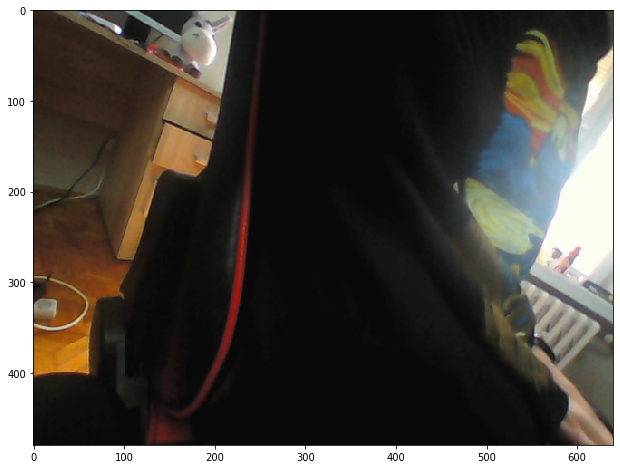

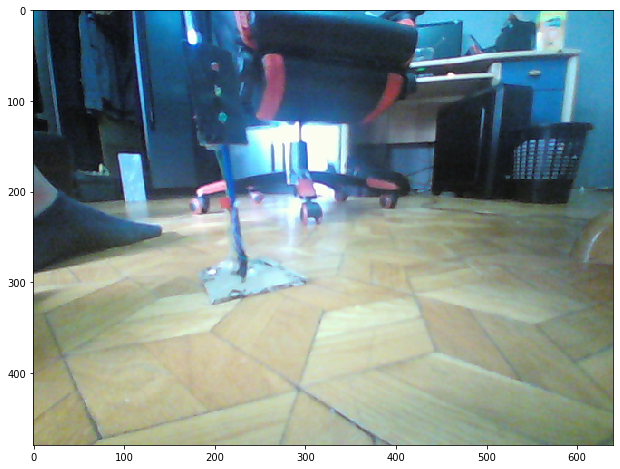

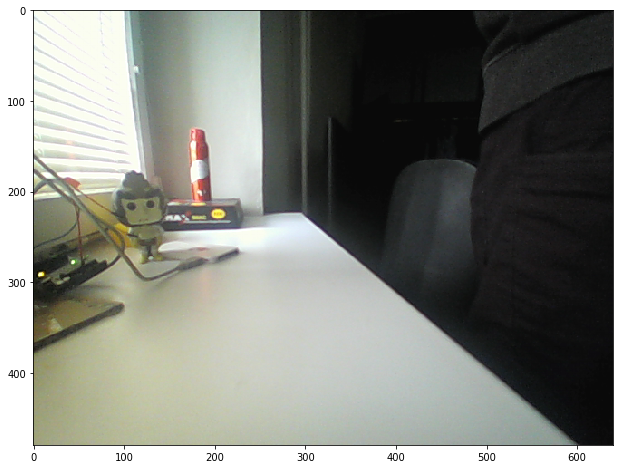

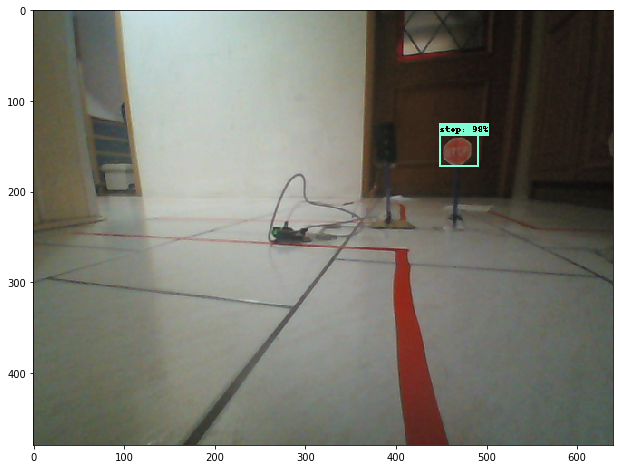

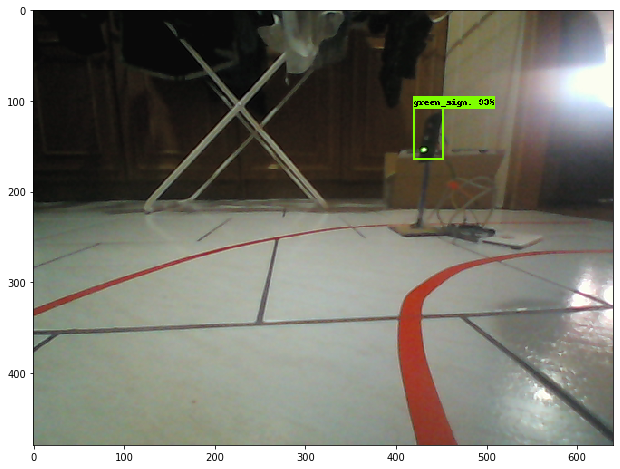

...

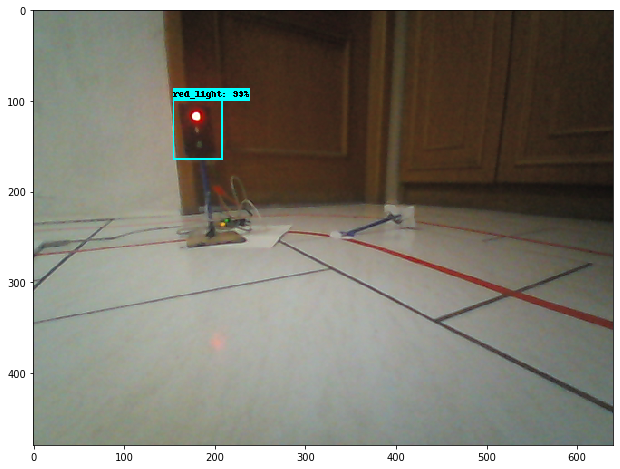

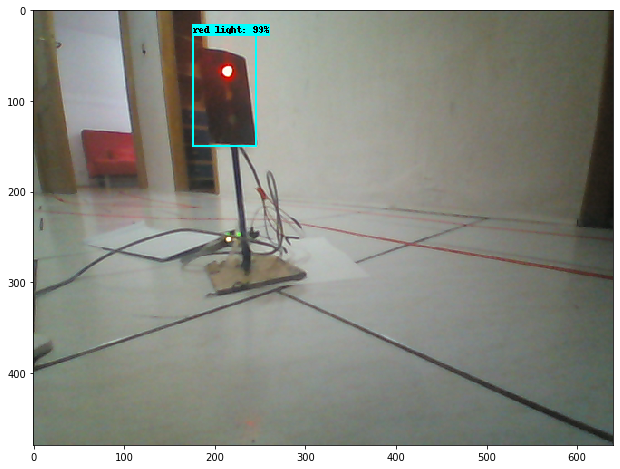

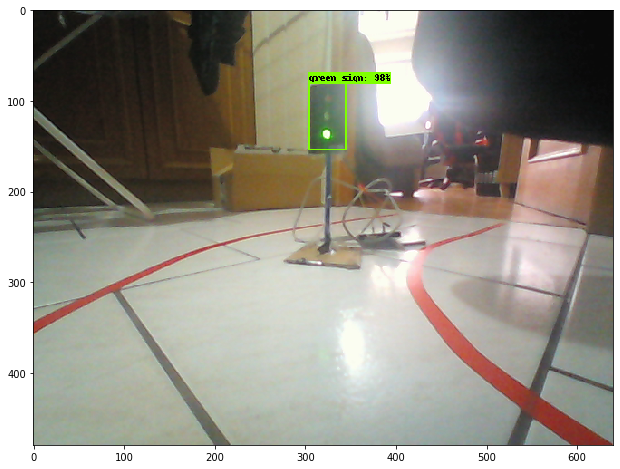

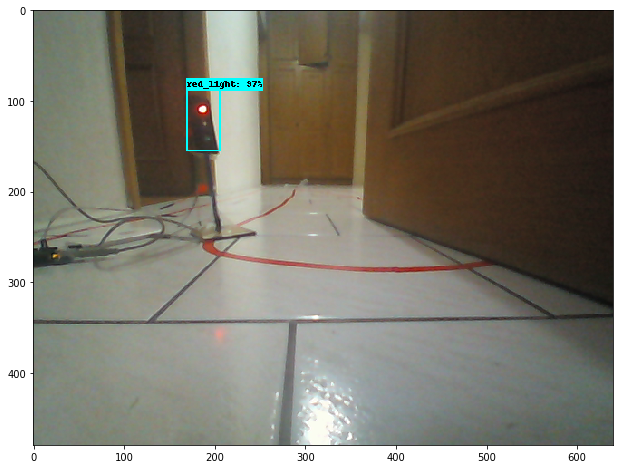

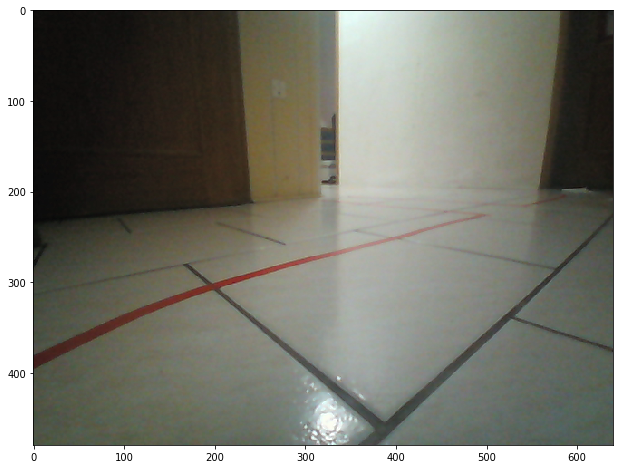

In [46]:
# running inferences.  This should show images with bounding boxes
%matplotlib inline
 
print('Running inferences on %s' % TEST_IMAGE_PATHS)
for image_path in TEST_IMAGE_PATHS:
    image = Image.open(image_path)
    # the array based representation of the image will be used later in order to prepare the
    # result image with boxes and labels on it.
    image_np = load_image_into_numpy_array(image)
    # Expand dimensions since the model expects images to have shape: [1, None, None, 3]
    image_np_expanded = np.expand_dims(image_np, axis=0)
    # Actual detection.
    print("PRZEEEEEEED")
    output_dict = run_inference_for_single_image(image_np, detection_graph)
    print("POOOOOOOO")
    # Visualization of the results of a detection.
    vis_util.visualize_boxes_and_labels_on_image_array(
        image_np,
        output_dict['detection_boxes'],
        output_dict['detection_classes'],
        output_dict['detection_scores'],
        category_index,
        instance_masks=output_dict.get('detection_masks'),
        use_normalized_coordinates=True,
        line_thickness=2)
    plt.figure(figsize=IMAGE_SIZE)
    plt.imshow(image_np)